#Numerical regression

in this example we will use Keras to predict wages based on various professional and demographic factors.

In [ ]:
# Import standard Libraries
import pandas as pd
import seaborn as sns
import altair as alt
import tensorflow as tf
import matplotlib.pyplot as plt



sns.set(rc={'figure.figsize':(10,10)})
print("imports ok")

imports ok


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


##Load Data

In [ ]:
# Load data file
# load dataset into Pandas DataFrame
data = pd.read_csv('/content/drive/MyDrive/Data - Encoding - Group/ALL_PARKS_TRAINING_10.csv')
pd.options.display.max_columns = None

print(data)

         city      area  Vegetation_Cover  Amenities_Total_Count  \
0     Firenze  0.001209          4.117744                     45   
1     Firenze  0.005393         17.130204                    104   
2     Firenze  0.026558         17.130534                     25   
3     Firenze  0.006754          2.441778                    106   
4     Firenze  0.144107          0.000000                     10   
...       ...       ...               ...                    ...   
2769     Roma  0.008737          2.619158                     20   
2770     Roma  0.112990          2.942963                     25   
2771     Roma  0.009490          7.706018                     13   
2772     Roma  0.094344          6.959208                     14   
2773     Roma  0.040827          2.595459                    101   

                                    park_name  reviews_count  weighted_rating  \
0              Piazza Giovambattista Giorgini             15         4.044113   
1                    

In [ ]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2774 entries, 0 to 2773
Data columns (total 15 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   city                         2774 non-null   object 
 1   area                         2774 non-null   float64
 2   Vegetation_Cover             2774 non-null   float64
 3   Amenities_Total_Count        2774 non-null   int64  
 4   park_name                    2774 non-null   object 
 5   reviews_count                2774 non-null   int64  
 6   weighted_rating              2774 non-null   float64
 7   sentiment_score              2774 non-null   float64
 8   avg_review_time              2774 non-null   int64  
 9   Amenities_Diversity_Shannon  2774 non-null   float64
 10  Amenities_Diversity          2774 non-null   float64
 11  Shape_Deviation              2774 non-null   float64
 12  Urban_Circulation_Amenities  2774 non-null   int64  
 13  Cultural_Context  

In [ ]:
data.describe()

,area,Vegetation_Cover,Amenities_Total_Count,reviews_count,weighted_rating,sentiment_score,avg_review_time,Amenities_Diversity_Shannon,Amenities_Diversity,Shape_Deviation,Urban_Circulation_Amenities,Cultural_Context,Urban_Features
count,2774.000000,2774.000000,2774.000000,2774.000000,2774.000000,2774.000000,2774.000000,2774.000000,2774.000000,2774.000000,2774.000000,2774.000000,2774.000000
mean,0.036787,29.361684,44.969358,230.515501,4.083056,0.866935,50578.485220,0.909897,0.270728,0.461570,20.102740,1.180606,23.686013
std,0.098412,34.659864,34.425156,279.887825,0.167187,0.344866,10053.410495,0.456129,0.129852,0.184347,19.122149,2.196817,26.982982
min,0.000213,0.000000,10.000000,5.000000,3.602629,-0.994600,7145.000000,0.000000,0.055556,0.000000,0.000000,0.000000,0.000000
25%,0.004242,2.282304,18.000000,31.000000,3.964321,0.934750,44372.250000,0.594275,0.166667,0.372644,8.000000,0.000000,4.000000
50%,0.011255,12.968243,32.000000,112.000000,4.070368,0.978000,50966.000000,0.928849,0.277778,0.474136,14.000000,0.000000,13.000000
75%,0.033536,47.089455,63.000000,330.000000,4.220292,0.991400,57710.250000,1.249940,0.333333,0.565578,26.000000,1.000000,34.000000
max,2.347218,100.000000,146.000000,1255.000000,4.647302,0.999600,79960.000000,2.113647,0.833333,0.964680,136.000000,32.000000,134.000000


In [ ]:
for colname, col in data.iteritems():
  print(colname, "min_val", col.min(), "max_val", col.max())

city min_val A CoruÃÂ±a max_val Wien
area min_val 0.000213379851055 max_val 2.347217578862616
Vegetation_Cover min_val 0.0 max_val 100.0
Amenities_Total_Count min_val 10 max_val 146
park_name min_val A Rosaleda max_val park PilskÃÂ¡
reviews_count min_val 5 max_val 1255
weighted_rating min_val 3.602628585177808 max_val 4.647301502607192
sentiment_score min_val -0.9946 max_val 0.9996
avg_review_time min_val 7145 max_val 79960
Amenities_Diversity_Shannon min_val 0.0 max_val 2.113647466199328
Amenities_Diversity min_val 0.0555555555555555 max_val 0.8333333333333334
Shape_Deviation min_val 0.0 max_val 0.96467988519769
Urban_Circulation_Amenities min_val 0 max_val 136
Cultural_Context min_val 0 max_val 32
Urban_Features min_val 0 max_val 134


<ipython-input-59-b7f7d95dacc0>:1: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for colname, col in data.iteritems():


we can see that some predictors are binary, while others are not

In [ ]:
data_binary = data[["union", "female", "marr", "south", "manufacturing", "construction"]]

In [ ]:
data_numerical = data([["wage_per_hour", "age", "education_yrs", "experience_yrs"]])
sns.pairplot(data_numerical)

We can see there is a direct relationship between age and experience, but not so much between wage and education, there is a non-linearity

##Prepare Data

**NORMALIZE INPUTS**

In [ ]:
columns_to_drop = ['city','park_name']

data =data.drop(columns=columns_to_drop)

In [ ]:
df_pca = pd.read_csv('/content/drive/MyDrive/Data - Encoding - Group/pcscores.csv') # replace 'pcscores.csv' with the path to your file

In [ ]:
data.columns

Index(['area', 'Vegetation_Cover', 'Amenities_Total_Count', 'reviews_count',
       'weighted_rating', 'sentiment_score', 'avg_review_time',
       'Amenities_Diversity_Shannon', 'Amenities_Diversity', 'Shape_Deviation',
       'Urban_Circulation_Amenities', 'Cultural_Context', 'Urban_Features'],
      dtype='object')

In [ ]:
print("First column name: ", data.columns[0])
print("Last column name: ", data.columns[-1])


First column name:  area
Last column name:  Urban_Features


In [ ]:
#same code as last time

# Get the names of 4th and 5th column
#cols_to_drop = data.columns[[6]]  # Adjust indices if necessary

# Drop the columns
# Drop the last 5 columns
X = df_pca.iloc[:, :-5]


# Load and instantiate a StandardSclaer
from sklearn.preprocessing import StandardScaler
scalerX = StandardScaler()

# Apply the scaler to our X-features
X_scaled = scalerX.fit_transform(X)

print(X_scaled.shape)

(2774, 9)


In [ ]:
#declare regression target
y = data.loc[:,"reviews_count"].to_numpy()


y = y.reshape(-1, 1)

from sklearn.preprocessing import MinMaxScaler
scalerY = MinMaxScaler()


#In this case it makes sense to use MinMax scaling because the wage seems like a relative range
# Apply the scaler to our Y-features
y_scaled = scalerY.fit_transform(y)

print(y_scaled.shape)
# print(y_scaled)


(2774, 1)


**SPLIT INTO TRAIN AND TEST**

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_scaled, test_size = 0.2, random_state = 21)

In [ ]:
#visualize our data
#we can see that scikitlearn doesnt care if it is a dataframe or a numpy array, because they all function on the same way
print("TRAIN", "input", X_train.shape, "output", y_train.shape)
print("TEST", "input", X_test.shape, "output", y_test.shape)
# print(X_test)
# print(y_test)

TRAIN input (2219, 9) output (2219, 1)
TEST input (555, 9) output (555, 1)


#Build model

From the cheatSheet
Regression between 0 and 1>>
      activation = relu for hidden layers / sigmoid for final layer
      loss = mean squared error
      optimizer = adam
      input from data, is 8 columns
      output is 1 value prediction

In [ ]:
# Instantiate a sequential model
tf.random.set_seed(5)
model = tf.keras.models.Sequential()
n_cols = X_scaled.shape[1]

# Add 2 dense layers of 50 and 32 neurons each
model.add(tf.keras.layers.Dense(4, input_shape=(n_cols,), activation='relu'))
model.add(tf.keras.layers.Dense(2, activation='relu'))

# Add a dense layer with 1 value output
model.add(tf.keras.layers.Dense(1, activation= "sigmoid"))

# Compile your model
model.compile(optimizer = "adam", loss = "mean_squared_error")


In [ ]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 4)                 40        
                                                                 
 dense_7 (Dense)             (None, 2)                 10        
                                                                 
 dense_8 (Dense)             (None, 1)                 3         
                                                                 
Total params: 53
Trainable params: 53
Non-trainable params: 0
_________________________________________________________________


#Train model

In [ ]:
# Fit your model to the training data for 200 epochs
#we assign this to history variable so we can plot the training data
history = model.fit(X_train,y_train,epochs=1000, validation_split=0.2)

Epoch 1/1000
56/56 [==============================] - 1s 5ms/step - loss: 0.1503 - val_loss: 0.1384
Epoch 2/1000
56/56 [==============================] - 0s 2ms/step - loss: 0.1266 - val_loss: 0.1147
Epoch 3/1000
56/56 [==============================] - 0s 2ms/step - loss: 0.1027 - val_loss: 0.0897
Epoch 4/1000
56/56 [==============================] - 0s 2ms/step - loss: 0.0782 - val_loss: 0.0658
Epoch 5/1000
56/56 [==============================] - 0s 2ms/step - loss: 0.0576 - val_loss: 0.0480
Epoch 6/1000
56/56 [==============================] - 0s 2ms/step - loss: 0.0430 - val_loss: 0.0363
Epoch 7/1000
56/56 [==============================] - 0s 3ms/step - loss: 0.0332 - val_loss: 0.0286
Epoch 8/1000
56/56 [==============================] - 0s 3ms/step - loss: 0.0267 - val_loss: 0.0237
Epoch 9/1000
56/56 [==============================] - 0s 2ms/step - loss: 0.0224 - val_loss: 0.0204
Epoch 10/1000
56/56 [==============================] - 0s 3ms/step - loss: 0.0195 - val_loss: 0.0181

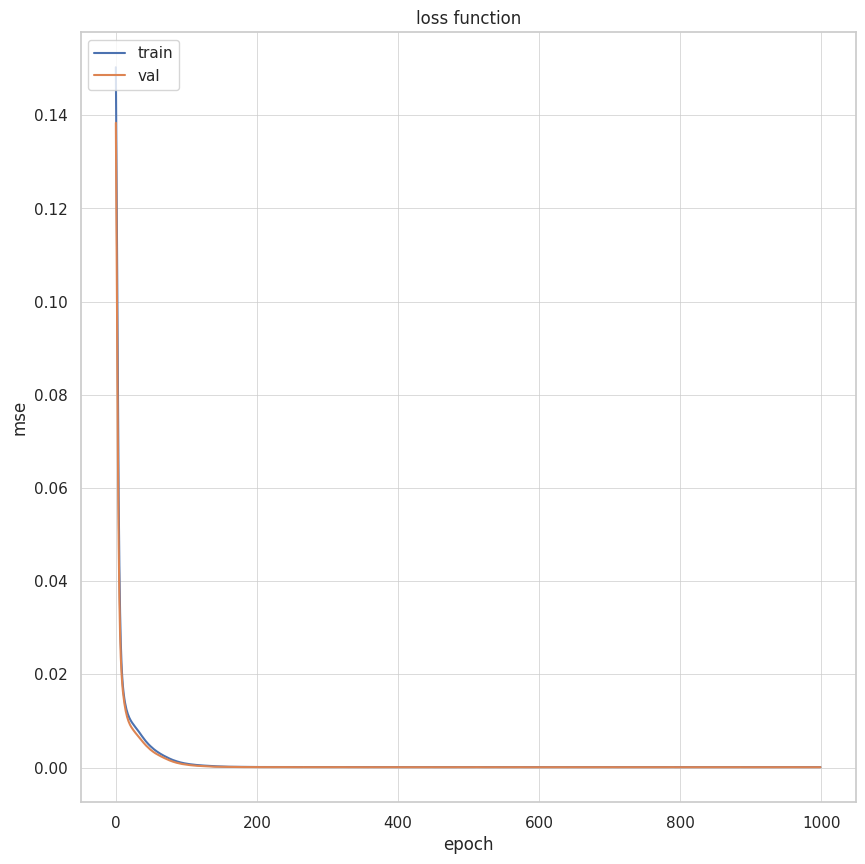

In [ ]:
# summarize history for accuracy
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('loss function')
plt.ylabel('mse')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

#Evaluate model on test data



In [ ]:
# Evaluate your model accuracy on the test data
loss_test = model.evaluate(X_test,y_test)

# Print accuracy
print('mse_test:', loss_test)

18/18 [==============================] - 0s 2ms/step - loss: 1.3246e-04
mse_test: 0.00013245771697256714


we can see the model is again slightly overfitting, but what does this translate in terms of USD accuracy of our prediction?

#Plot error


In [ ]:
def plot_comparison(x_val, pred, truth, xlab, ylab):
  fig, ax1 = plt.subplots()
  ax1.plot(x_val, truth, color = "red", label = "truth",linestyle='None', marker = "o", markersize = 5)
  ax1.plot(x_val, pred, color = "blue", label = "pred",linestyle='None', marker = "o", markersize = 4, alpha = 0.5)

  ax1.set_xlabel(xlab)
  ax1.set_ylabel(ylab)
  ax1.legend()
  fig.set_figheight(10)
  fig.set_figwidth(20)
  plt.title('Prediction Comparison')
  plt.show()

18/18 [==============================] - 0s 1ms/step


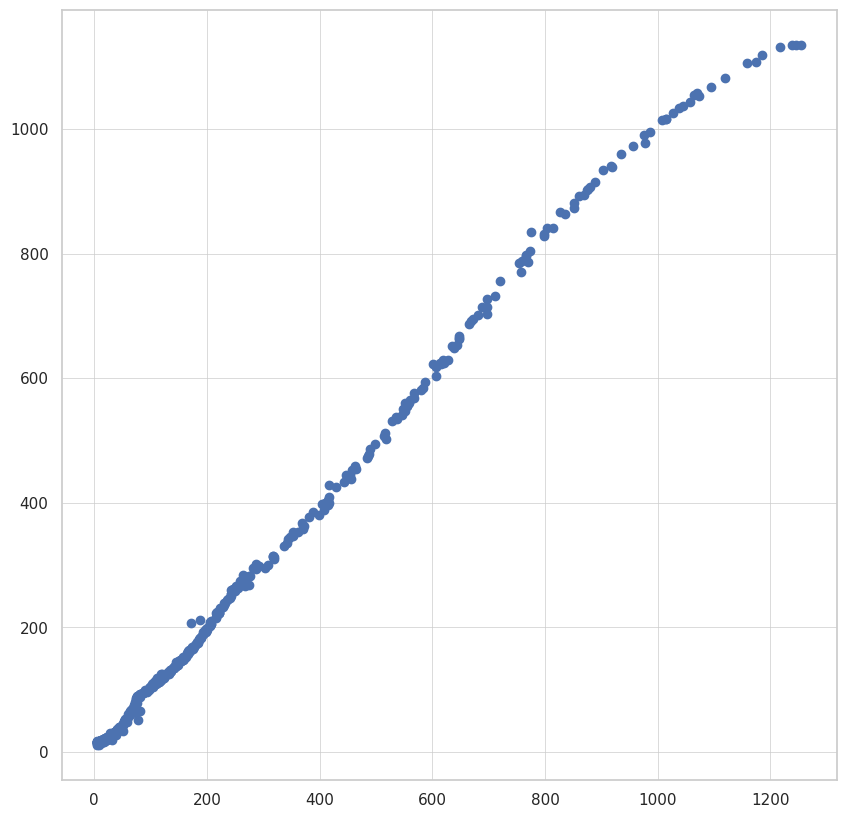

In [ ]:
y_pred = scalerY.inverse_transform(model.predict(X_test))
y_truth = scalerY.inverse_transform(y_test)

plt.scatter(y_truth,y_pred)

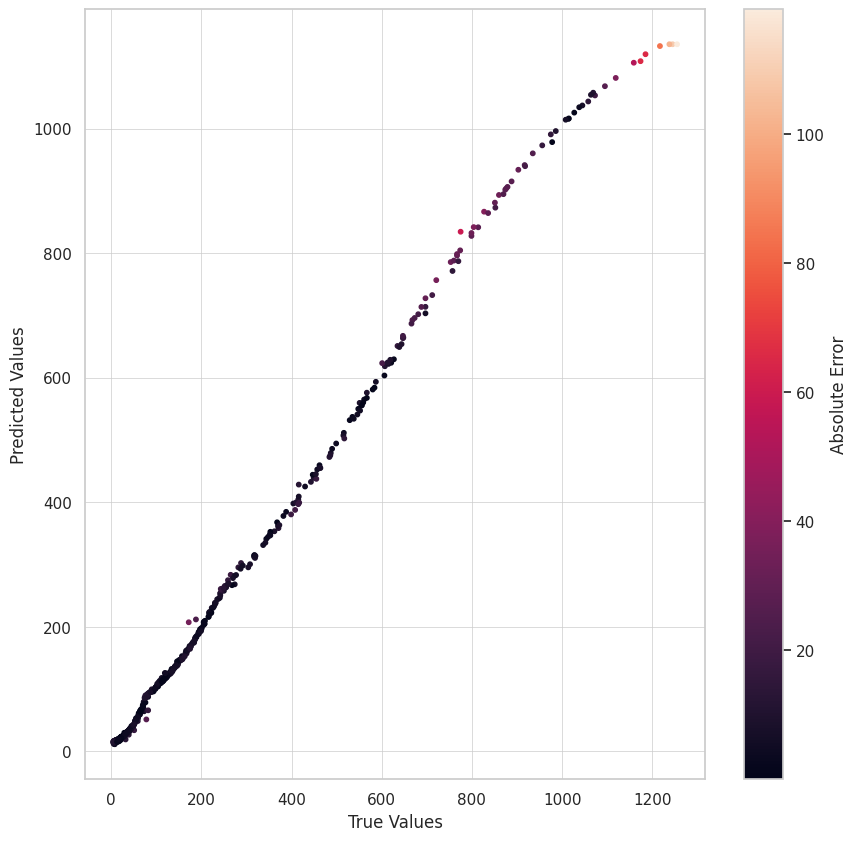

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Calculate absolute error
error = np.abs(y_pred - y_truth)

# Create scatter plot with smaller dots
plt.scatter(y_truth, y_pred, c=error, s=10)  # Here, s is set to 10. You can adjust this value as needed.

# Add a colorbar to the plot to interpret the colors
plt.colorbar(label='Absolute Error')

plt.xlabel('True Values')
plt.ylabel('Predicted Values')

plt.show()


[-19.16886734 -27.55077708 -14.49348388  71.63167815 -28.06689645
 -10.59647674  35.21752753 -12.06487354  70.27312621 -18.10744075
 -24.684285    62.20461091  24.62261552  -4.737083   -33.69793856
 -20.65498985 -21.49942209  38.91659968  37.68900506 -27.44680139
 -34.70883999 -41.79621021 -31.53534338 -13.57117909 -18.06227947
 -32.35671531 -26.23559876  15.54604003 -28.05037208  39.58075555
   6.83000289 -18.51906366  -8.66839414 -24.63384445  62.85098135
 -19.77090524 -24.94146718 -25.00054695  -6.70514765 -11.23586331
  43.917425   -26.71739766  74.81060803 -23.55181776 -14.20784563
 -31.42563213 -31.42211764 -26.42591731 -11.82224113 -26.97655591
  -2.92155584 -27.02760765 -27.38750125 -22.24697271 -27.17421509
   2.62314633  73.20293061 -27.50678586  -0.43514489 -22.67182689
 -29.34922473 -22.09803518 -27.07364936  83.49798517 -33.63981401
 -15.96360321   3.74819769 -31.39074635  12.82911779  72.02338077
 -20.50608477  16.40754145 -29.4871999   71.13113707 -27.96211502
 -25.35898

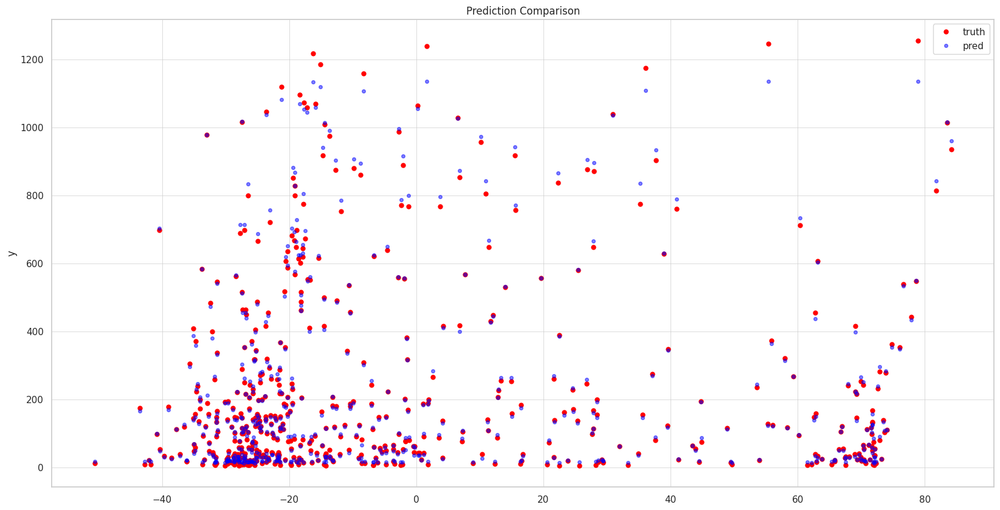

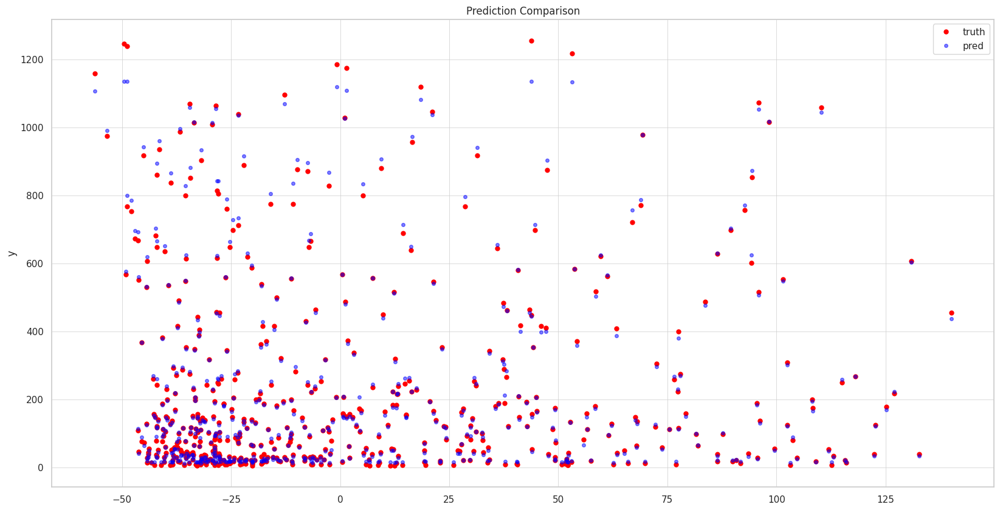

In [ ]:
age_test = (scalerX.inverse_transform(X_test)[:,3])
print(age_test)

exp_test = (scalerX.inverse_transform(X_test)[:,2])

plot_comparison(age_test, y_pred, y_truth, "", "y")
plot_comparison(exp_test, y_pred, y_truth,  "", "y")

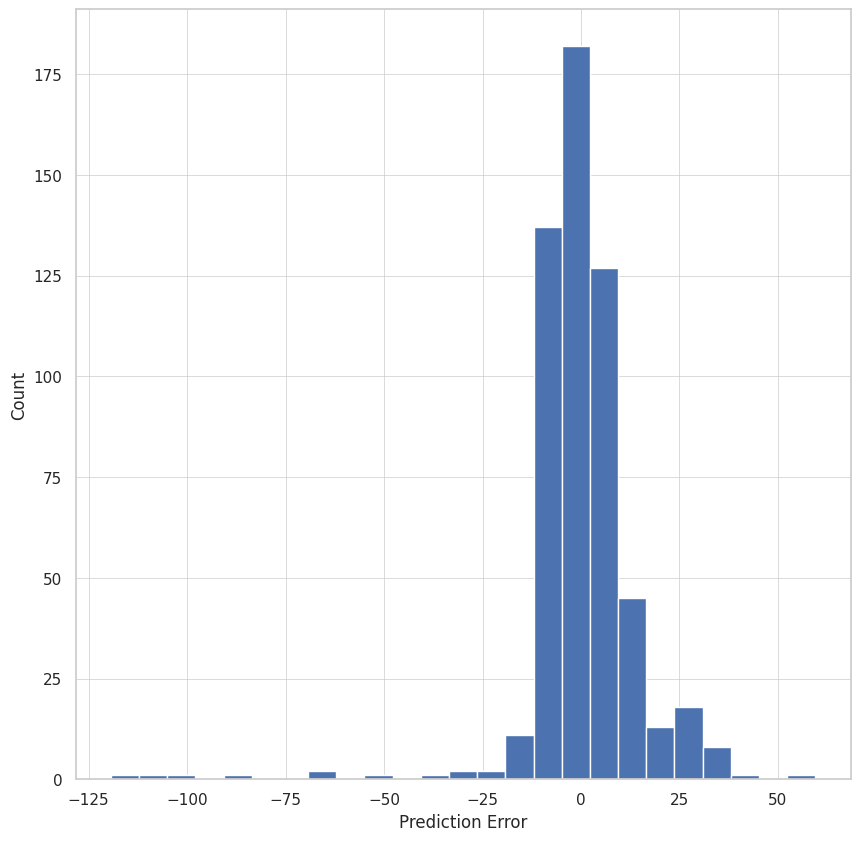

In [ ]:
error = y_pred - y_truth
plt.hist(error, bins=25)
plt.xlabel('Prediction Error')
_ = plt.ylabel('Count')

# random forest

In [ ]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
# Import necessary library
import numpy as np


# Keep only numerical columns
numerical_cols = data.select_dtypes(include=np.number).columns.tolist()
data = data[numerical_cols]

# Specify your target column
target_col = "weighted_rating"

# Create features (X) and target (y) dataframes
X = data.drop(columns=[target_col])
y = data[target_col]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train a Decision Tree regressor
tree = DecisionTreeRegressor(random_state=42)
tree.fit(X_train, y_train)

# Predict on test data
tree_predictions = tree.predict(X_test)

# Print the root mean square error of the Decision Tree model
print("Decision Tree RMSE:", np.sqrt(mean_squared_error(y_test, tree_predictions)))

# Initialize and train a Random Forest regressor
forest = RandomForestRegressor(random_state=42)
forest.fit(X_train, y_train)

# Predict on test data
forest_predictions = forest.predict(X_test)

# Print the root mean square error of the Random Forest model
print("Random Forest RMSE:", np.sqrt(mean_squared_error(y_test, forest_predictions)))


Decision Tree RMSE: 0.22985661512260608
Random Forest RMSE: 0.1638575474233907


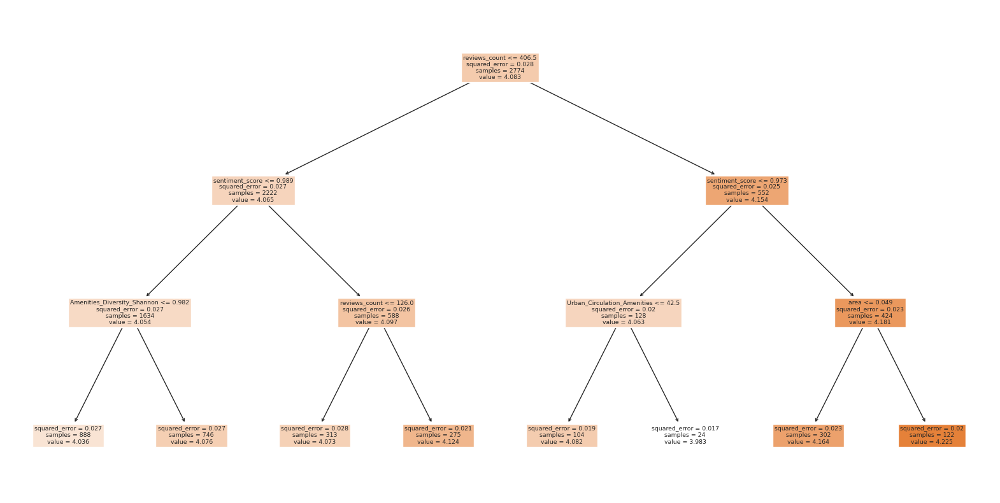

In [ ]:
# Import necessary libraries
from sklearn.tree import DecisionTreeRegressor, plot_tree
import matplotlib.pyplot as plt

# Separate the features and the target variable
X = data_num.drop('weighted_rating', axis=1)
y = data_num['weighted_rating']

# Train the decision tree regressor
dtree = DecisionTreeRegressor(max_depth=3)
dtree.fit(X, y)

# Plot the decision tree
plt.figure(figsize=(20,10))
plot_tree(dtree, feature_names=X.columns, filled=True)
plt.show()


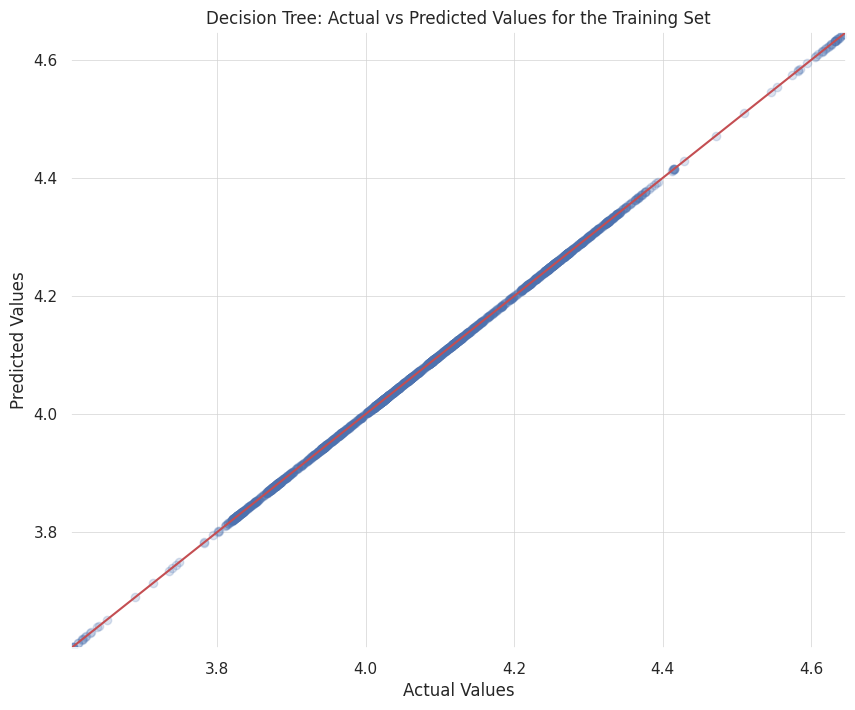

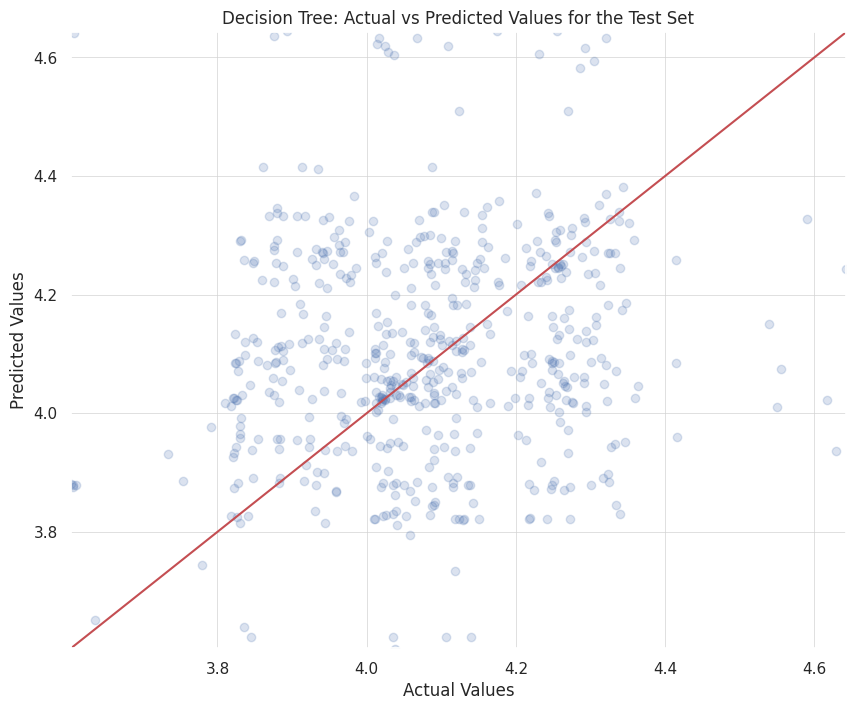

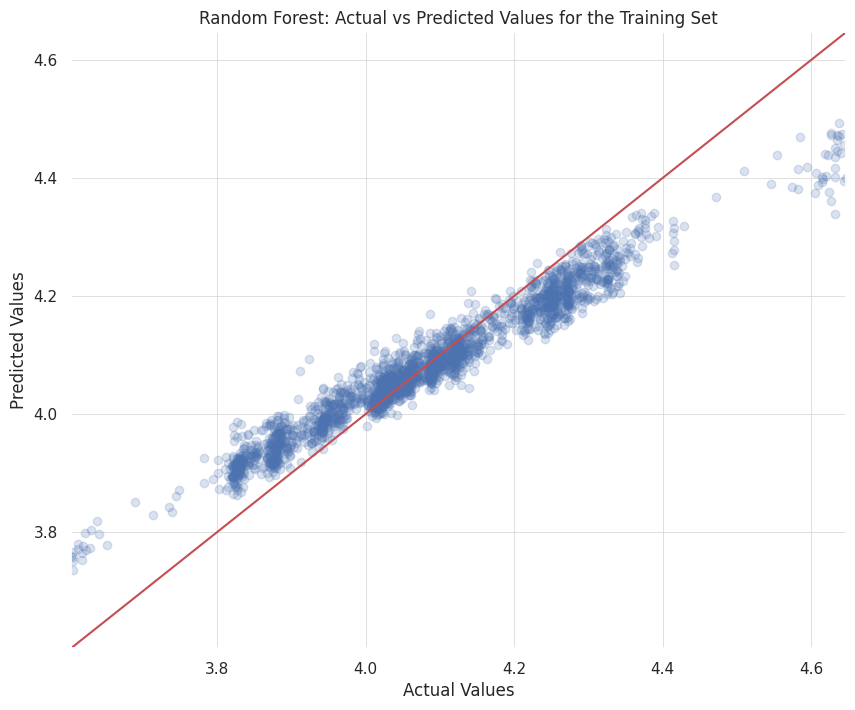

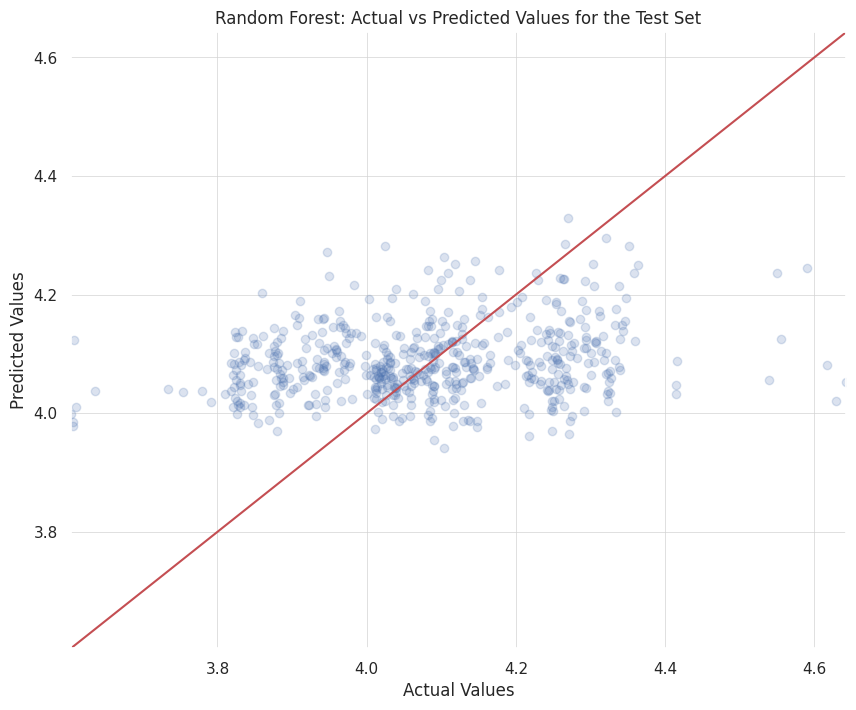

In [ ]:
# Import necessary libraries
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
import numpy as np
import matplotlib.pyplot as plt

# Train the Decision Tree model
dt = DecisionTreeRegressor(random_state=42)
dt.fit(X_train, y_train)

# Predict with the Decision Tree model on the training set
y_train_pred_dt = dt.predict(X_train)

# Predict with the Decision Tree model on the test set
y_test_pred_dt = dt.predict(X_test)

# Train the Random Forest model
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train, y_train)

# Predict with the Random Forest model on the training set
y_train_pred_rf = rf.predict(X_train)

# Predict with the Random Forest model on the test set
y_test_pred_rf = rf.predict(X_test)

# Decision Tree plots
plt.figure(figsize=(10, 8))
plt.scatter(y_train, y_train_pred_dt, alpha=0.2)
plt.plot([min(y_train), max(y_train)], [min(y_train), max(y_train)], 'r')
plt.xlim([min(y_train), max(y_train)])
plt.ylim([min(y_train), max(y_train)])
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Decision Tree: Actual vs Predicted Values for the Training Set')
plt.show()

plt.figure(figsize=(10, 8))
plt.scatter(y_test, y_test_pred_dt, alpha=0.2)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'r')
plt.xlim([min(y_test), max(y_test)])
plt.ylim([min(y_test), max(y_test)])
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Decision Tree: Actual vs Predicted Values for the Test Set')
plt.show()

# Random Forest plots
plt.figure(figsize=(10, 8))
plt.scatter(y_train, y_train_pred_rf, alpha=0.2)
plt.plot([min(y_train), max(y_train)], [min(y_train), max(y_train)], 'r')
plt.xlim([min(y_train), max(y_train)])
plt.ylim([min(y_train), max(y_train)])
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Random Forest: Actual vs Predicted Values for the Training Set')
plt.show()

plt.figure(figsize=(10, 8))
plt.scatter(y_test, y_test_pred_rf, alpha=0.2)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'r')
plt.xlim([min(y_test), max(y_test)])
plt.ylim([min(y_test), max(y_test)])
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Random Forest: Actual vs Predicted Values for the Test Set')
plt.show()


# kmeans

In [ ]:
import pandas as pd

file_path = '/content/drive/MyDrive/Data - Encoding - Group/ALL_PARKS_TRAINING_5.csv'  # replace with your file path
data = pd.read_csv(file_path)


In [ ]:
# Keep only numerical columns
numerical_cols = data.select_dtypes(include=[np.number]).columns.tolist()
data_num = data[numerical_cols]

# Import necessary libraries
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Perform K-means clustering
kmeans = KMeans(n_clusters=3, random_state=42)
kmeans.fit(data_num)

# Create labels
labels = kmeans.labels_

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(data_num, labels, test_size=0.2, random_state=42)

# Train a random forest classifier
clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(X_train, y_train)

# Predict the labels for the testing data
y_pred = clf.predict(X_test)

# Print the accuracy of the classifier
print("Accuracy:", accuracy_score(y_test, y_pred))


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Accuracy: 1.0


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-69-85ed34d1dfc7>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_num['Cluster'] = km.fit_predict(data_num)


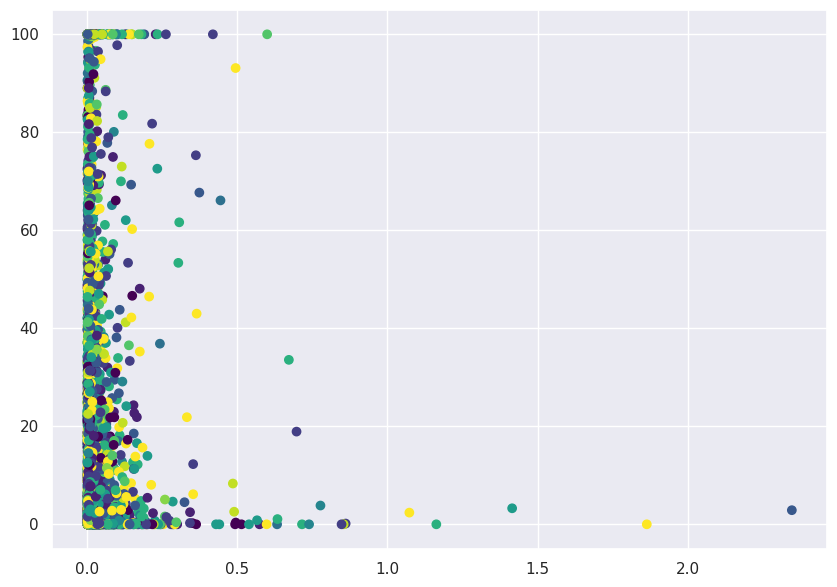

In [ ]:
import matplotlib.pyplot as plt

# Fit the KMeans model to the data and predict the cluster assignments for each data point
km = KMeans(n_clusters=12, random_state=42)
data_num['Cluster'] = km.fit_predict(data_num)

# Plot the data colored by the KMeans cluster assignments
plt.figure(figsize=(10, 7))
plt.scatter(data_num.iloc[:, 0], data_num.iloc[:, 1], c=data_num['Cluster'], cmap='viridis')

# Display the plot
plt.show()


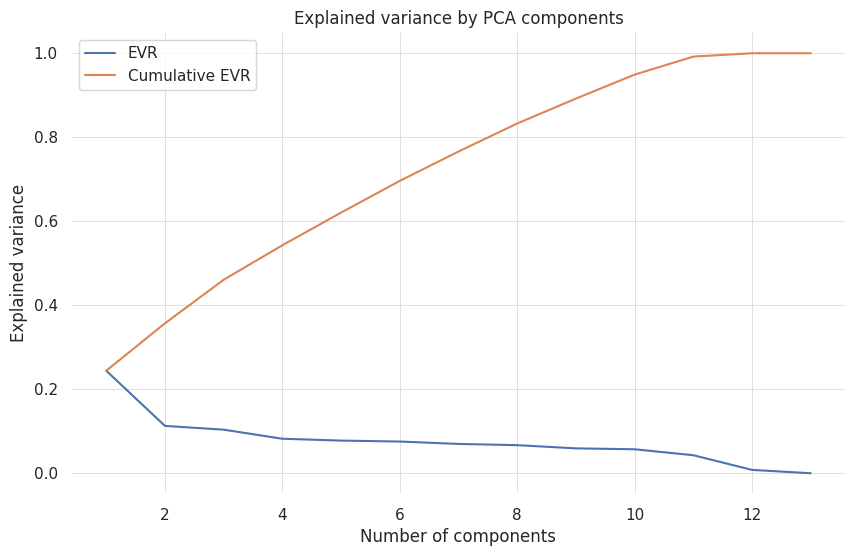

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


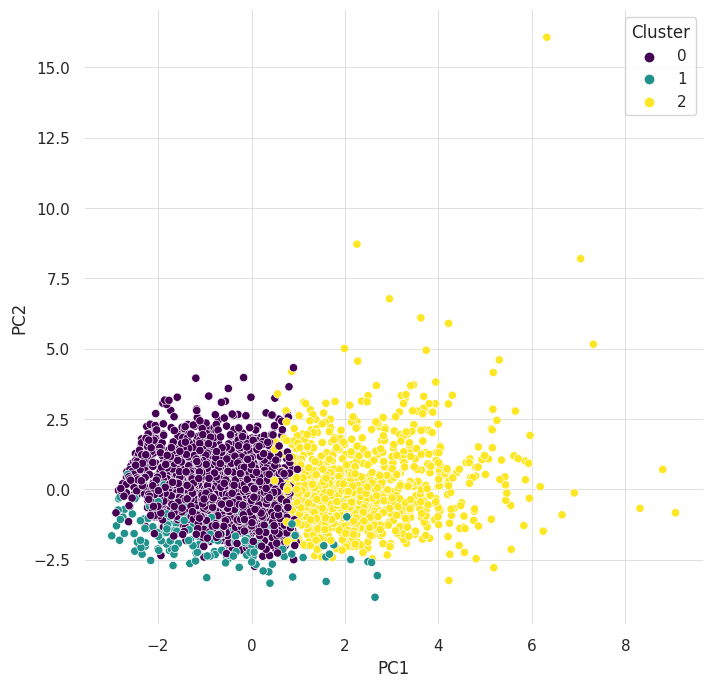

In [ ]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns



# Standardizing the features
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data_num)

# Perform PCA
pca = PCA()
principalComponents = pca.fit_transform(data_scaled)
pcscores = pd.DataFrame(principalComponents, columns=['PC'+str(i) for i in range(1, len(pca.explained_variance_)+1)])

# Plot the explained variance ratio
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(pca.explained_variance_)+1), pca.explained_variance_ratio_, label='EVR')
plt.plot(range(1, len(pca.explained_variance_)+1), np.cumsum(pca.explained_variance_ratio_), label='Cumulative EVR')
plt.title('Explained variance by PCA components')
plt.xlabel('Number of components')
plt.ylabel('Explained variance')
plt.grid(True)
plt.legend()
plt.show()

# Perform k-means clustering on the filtered dataframe
kmeans = KMeans(n_clusters=3, random_state=42)
kmeans.fit(pcscores)

# Add the labels to the dataframe
pcscores['Cluster'] = kmeans.labels_

# Plotting the clusters
plt.figure(figsize=(8, 8))
sns.scatterplot(data=pcscores, x='PC1', y='PC2', hue='Cluster', palette='viridis')
plt.show()


In [ ]:
# Import necessary libraries
import numpy as np
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Select rows that fall in the 50% quintile based on 'reviews_count'
lower, upper = data['reviews_count'].quantile([0.25, 0.75])
data_filtered = data[(data['reviews_count'] >= lower) & (data['reviews_count'] <= upper)]

# Keep only numerical columns
numerical_cols = data_filtered.select_dtypes(include=[np.number]).columns.tolist()
data_num = data_filtered[numerical_cols]

# Perform K-means clustering
kmeans = KMeans(n_clusters=12, random_state=42)
kmeans.fit(data_num)

# Create labels
labels = kmeans.labels_

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(data_num, labels, test_size=0.5, random_state=42)

# Train a random forest classifier
clf = RandomForestClassifier(n_estimators=10000, random_state=42)
clf.fit(X_train, y_train)

# Predict the labels for the testing data
y_pred = clf.predict(X_test)

# Print the accuracy of the classifier
print("Accuracy:", accuracy_score(y_test, y_pred))

# Fit the KMeans model to the data and predict the cluster assignments for each data point
km = KMeans(n_clusters=3, random_state=42)
data_num['Cluster'] = km.fit_predict(data_num)

# Plot the data colored by the KMeans cluster assignments
plt.figure(figsize=(10, 7))
plt.scatter(data_num.iloc[:, 0], data_num.iloc[:, 1], c=data_num['Cluster'], cmap='viridis')

# Display the plot
plt.show()


# tsne

In [ ]:
!pip install umap-learn


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 4.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 29.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82816 sha256=1a896aeebfc08887ea0342a9b7df48dd6b6fc2a2479a96898f7207ef12982a7d
  Stored in directory: /root/.cache/pip/wheels/a0/e8/c6/a37ea663620bd5200ea1ba0907ab3c217042c1d035ef606acc
  Created wheel for pynndescent: filename=pynndescent-0.5.10-py3-none-any.whl size=55622 sha256=dcb8c034eaf832ae896207ed9441a2019515750a2084e096b1b5feec44f1b1c5
  Stored in directory: /root/.cache/pip/wheels/4a/38/5d/f60a40a66a9512b7e5e83517ebc2d1b42d857be97d135f1096
Successfully built umap-learn pynndescent


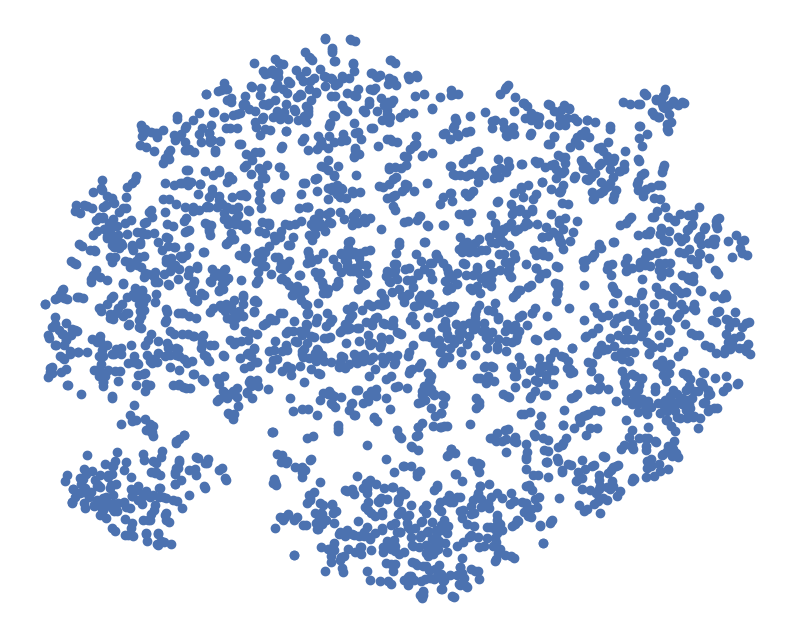

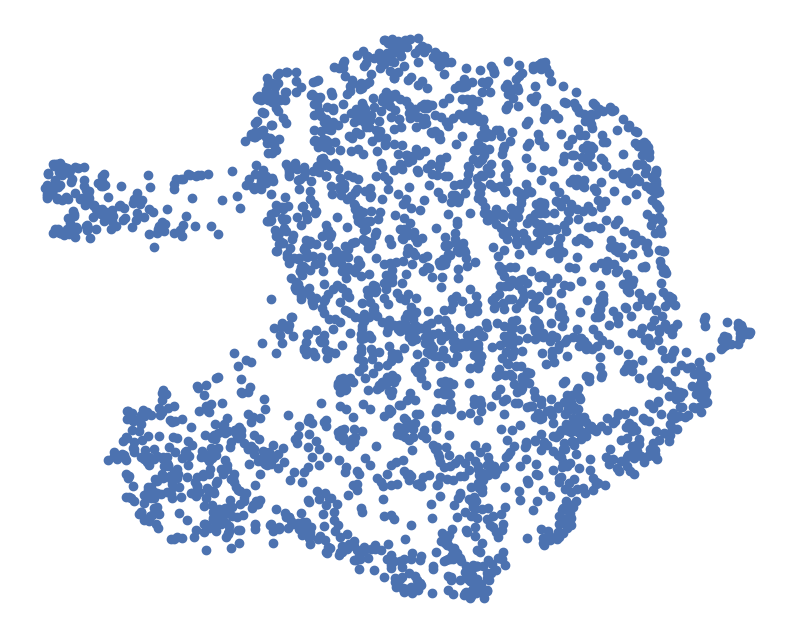

In [ ]:
# Import required libraries
from sklearn.manifold import TSNE
from umap import UMAP
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import numpy as np
# Select only numerical columns
data_num = data.select_dtypes(include=np.number)

# Standardize the data
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data_num)

# Apply t-SNE
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(data_scaled)

# Plot t-SNE results
plt.figure(figsize=(10,8))
plt.scatter(tsne_results[:, 0], tsne_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

# Apply UMAP
umap = UMAP(n_components=2, random_state=42)
umap_results = umap.fit_transform(data_scaled)

# Plot UMAP results
plt.figure(figsize=(10,8))
plt.scatter(umap_results[:, 0], umap_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


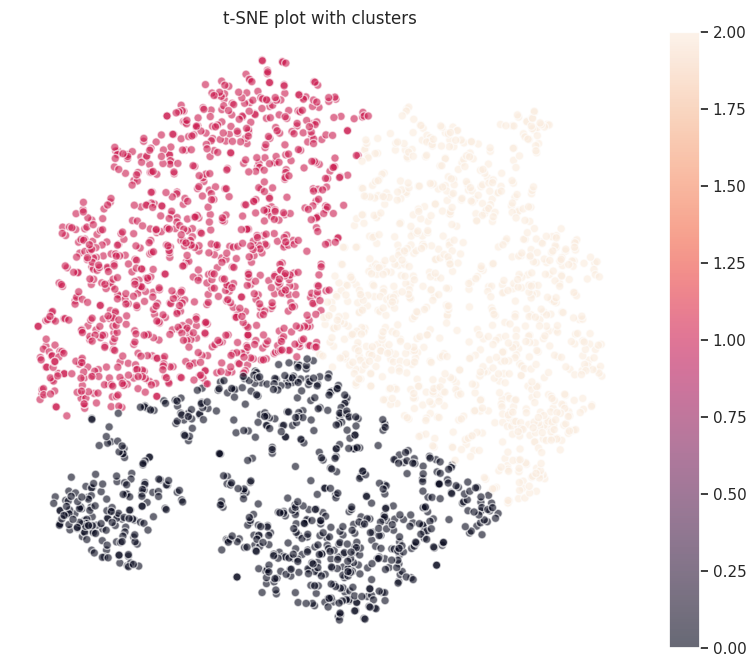

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


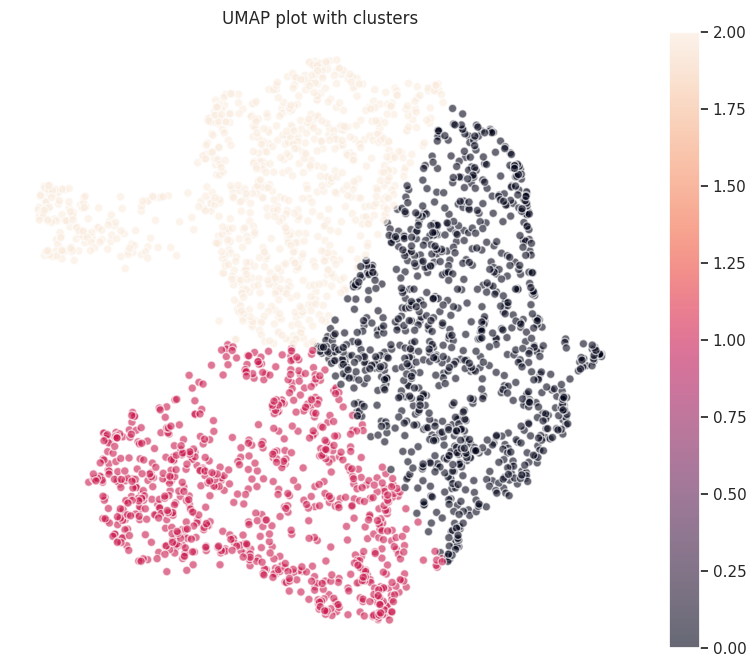

In [ ]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Adjust plot style
plt.rcParams['axes.facecolor'] = 'white' # makes the background white
plt.rcParams['grid.color'] = 'lightgrey' # makes gridlines light grey
plt.rcParams['grid.linestyle'] = '-' # defines the style of the gridlines
plt.rcParams['grid.linewidth'] = 0.5 # defines the width of the gridlines

def plot_with_clusters(data, title):
    # Perform k-means clustering. Here, I am assuming 3 clusters.
    # You should change this to suit your data.
    kmeans = KMeans(n_clusters=3)
    kmeans.fit(data)

    # Use the cluster labels as colors
    plt.figure(figsize=(10,8))
    scatter = plt.scatter(data[:, 0], data[:, 1], c=kmeans.labels_, alpha=0.6, edgecolors='w')

    plt.title(title, fontsize=12)
    plt.colorbar(scatter)
    plt.grid(True)  # Add gridlines
    plt.xticks([])  # Remove x-axis values
    plt.yticks([])  # Remove y-axis values
    plt.axis('off')
    plt.show()

# Now we apply the function to our t-SNE and UMAP results

# t-SNE plot
plot_with_clusters(tsne_results, 't-SNE plot with clusters')

# UMAP plot
plot_with_clusters(umap_results, 'UMAP plot with clusters')


In [ ]:
from sklearn.cluster import KMeans

# Create a KMeans object with the desired number of clusters
kmeans = KMeans(n_clusters=3)

# Perform clustering on the t-SNE results
kmeans.fit(tsne_results)

# Add the cluster labels back to the original DataFrame
data['cluster'] = kmeans.labels_

# Check the DataFrame
print(data.head())


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


      city      area  Vegetation_Cover  Amenities_Total_Count  \
0  Firenze  0.001209          4.117744                     45   
1  Firenze  0.005393         17.130204                    104   
2  Firenze  0.026558         17.130534                     25   
3  Firenze  0.006754          2.441778                    106   
4  Firenze  0.144107          0.000000                     10   

                        park_name  reviews_count  weighted_rating  \
0  Piazza Giovambattista Giorgini             15         4.044113   
1           Piazza della Vittoria            508         4.058028   
2                  Lippi's Garden             40         4.066201   
3           Piazza Torquato Tasso            152         4.048828   
4              Parco Chico Mendez            574         4.143546   

   sentiment_score  avg_review_time  Amenities_Diversity_Shannon  \
0           0.9911            51612                     0.961499   
1           0.9786            68952                     1.

In [ ]:
# Get rows associated with Cluster 1
cluster_1_data = data[data['cluster'] == 1]

# Print rows associated with Cluster 1
cluster_1_data


,city,area,Vegetation_Cover,Amenities_Total_Count,park_name,reviews_count,weighted_rating,sentiment_score,avg_review_time,Amenities_Diversity_Shannon,Amenities_Diversity,Shape_Deviation,Urban_Circulation_Amenities,Cultural_Context,Urban_Features,cluster
1,Firenze,0.005393,17.130204,104,Piazza della Vittoria,508,4.058028,0.9786,68952,1.354215,0.388889,0.380623,32,1,71,1
3,Firenze,0.006754,2.441778,106,Piazza Torquato Tasso,152,4.048828,0.8126,46706,1.076296,0.500000,0.567677,30,6,70,1
8,Firenze,0.051333,1.538331,90,Parco di Villa Vogel,78,4.031288,0.9906,59290,0.668449,0.333333,0.683119,75,0,15,1
10,Firenze,0.063151,0.976932,59,Scuola di Ingegneria,27,4.046362,0.9487,49768,0.762980,0.166667,0.430854,19,0,40,1
12,Firenze,0.002060,27.565605,57,Piazza Giacomo Puccini,13,4.036159,0.5751,42084,0.742903,0.277778,0.833028,11,1,45,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2747,Roma,0.044204,22.851609,95,Giardini del Quirinale,380,3.927391,0.9855,47416,1.278839,0.388889,0.465150,59,23,13,1
2748,Roma,0.068870,5.235151,69,Parco Ponte Di Nona,94,3.837596,0.9234,48997,0.151289,0.166667,0.565024,67,1,1,1
2759,Roma,0.030342,1.054297,34,Parco Ex-Snia,242,3.875261,0.9529,50463,1.485004,0.388889,0.657959,14,1,19,1
2765,Roma,0.025864,2.339879,22,Verde Pavese,22,3.831532,0.9902,56268,1.071284,0.222222,0.508600,13,4,5,1


In [ ]:
# Get rows associated with Cluster 1
cluster_2_data = data[data['cluster'] == 2]

# Print rows associated with Cluster 1
cluster_2_data

,city,area,Vegetation_Cover,Amenities_Total_Count,park_name,reviews_count,weighted_rating,sentiment_score,avg_review_time,Amenities_Diversity_Shannon,Amenities_Diversity,Shape_Deviation,Urban_Circulation_Amenities,Cultural_Context,Urban_Features,cluster
0,Firenze,0.001209,4.117744,45,Piazza Giovambattista Giorgini,15,4.044113,0.9911,51612,0.961499,0.277778,0.522690,15,2,28,2
5,Firenze,0.008802,8.051253,51,Parco Giochi Via Undici Febbraio,9,4.041456,-0.3910,43643,0.192626,0.166667,0.445778,1,0,50,2
13,Firenze,0.015785,100.000000,53,Giardino Corsini,321,4.107360,0.9963,31298,0.931096,0.277778,0.706835,35,4,14,2
15,Firenze,0.004188,5.415643,27,Parco Giochi Cortona,16,4.044151,0.9904,62013,0.970754,0.277778,0.513789,8,0,19,2
20,Firenze,0.017521,1.125862,38,Parco Bardo,67,4.050355,0.9741,50736,0.821549,0.222222,0.448572,8,1,29,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2760,Roma,0.049423,100.000000,11,Parco Umberto Lenzini,10,3.828535,0.9792,62932,0.759547,0.166667,0.710590,8,2,1,2
2766,Roma,0.001403,100.000000,12,Parco della Scienza,752,3.935036,0.9810,59218,0.836988,0.222222,0.334566,1,0,11,2
2768,Roma,0.006871,59.523678,10,Parco del Serpente,9,3.821519,0.7096,58226,1.088900,0.222222,0.415499,6,0,4,2
2771,Roma,0.009490,7.706018,13,Parco Urbano di Via Domenico Purificato,76,3.811122,-0.9822,42241,0.000000,0.055556,0.758833,13,0,0,2


In [ ]:
# Get rows associated with Cluster 1
cluster_3_data = data[data['cluster'] == 0]

# Print rows associated with Cluster 1
cluster_3_data

,city,area,Vegetation_Cover,Amenities_Total_Count,park_name,reviews_count,weighted_rating,sentiment_score,avg_review_time,Amenities_Diversity_Shannon,Amenities_Diversity,Shape_Deviation,Urban_Circulation_Amenities,Cultural_Context,Urban_Features,cluster
2,Firenze,0.026558,17.130534,25,Lippi's Garden,40,4.066201,0.9969,38868,0.167944,0.111111,0.529157,25,0,0,0
4,Firenze,0.144107,0.000000,10,Parco Chico Mendez,574,4.143546,0.9652,50035,0.639032,0.166667,0.498890,8,0,2,0
6,Firenze,0.020008,3.936236,17,Parco D'Arte Enzo Pazzagli,752,4.062633,0.9951,54797,0.691416,0.111111,0.471967,8,0,9,0
7,Firenze,0.031349,0.460672,10,Parco dell'Ambrogiana,484,4.107002,0.9672,32939,0.325083,0.111111,0.458396,9,0,1,0
9,Firenze,0.010199,0.000000,10,Piazza Dante,17,4.048755,0.8896,56749,0.639032,0.166667,0.539747,0,1,9,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2763,Roma,0.342058,0.268942,47,Parco Talenti,54,3.838271,0.9908,48281,0.891083,0.277778,0.567819,35,4,8,0
2764,Roma,0.034429,0.000000,23,Parco delle Mimose,496,3.920244,0.7502,48519,1.001422,0.222222,0.641160,6,0,17,0
2767,Roma,0.006286,36.470654,15,Parco Anna Magnani,45,3.834109,0.9815,46408,0.000000,0.055556,0.781161,15,0,0,0
2769,Roma,0.008737,2.619158,20,Passeggiata del Gianicolo,830,4.019194,0.9766,54542,0.983600,0.277778,0.399488,14,1,5,0


In [ ]:
from sklearn.preprocessing import MinMaxScaler
import pandas as pd

# Drop the unneeded columns
cluster_1_data = cluster_1_data.drop(columns=["city", "park_name", "cluster"])

# Calculate the means for each column
cluster_1_means = pd.DataFrame(cluster_1_data.mean(), columns=["mean"]).T

# Apply the scaler to all columns
scaler = MinMaxScaler(feature_range=(0, 10))  # range to scale to
cluster_1_means_scaled = scaler.fit_transform(cluster_1_means)

# Convert scaled array back to DataFrame
cluster_1_means_scaled = pd.DataFrame(cluster_1_means_scaled, columns=cluster_1_means.columns)

# Now, you can plot the radar plot with `cluster_1_means_scaled`


In [ ]:
# Save DataFrame to CSV
cluster_1_data.to_csv("/content/drive/MyDrive/Data - Encoding - Group/cluster_1_data.csv", index=False)
cluster_2_data.to_csv("/content/drive/MyDrive/Data - Encoding - Group/cluster_2_data.csv", index=False)
cluster_3_data.to_csv("/content/drive/MyDrive/Data - Encoding - Group/cluster_0_data.csv", index=False)


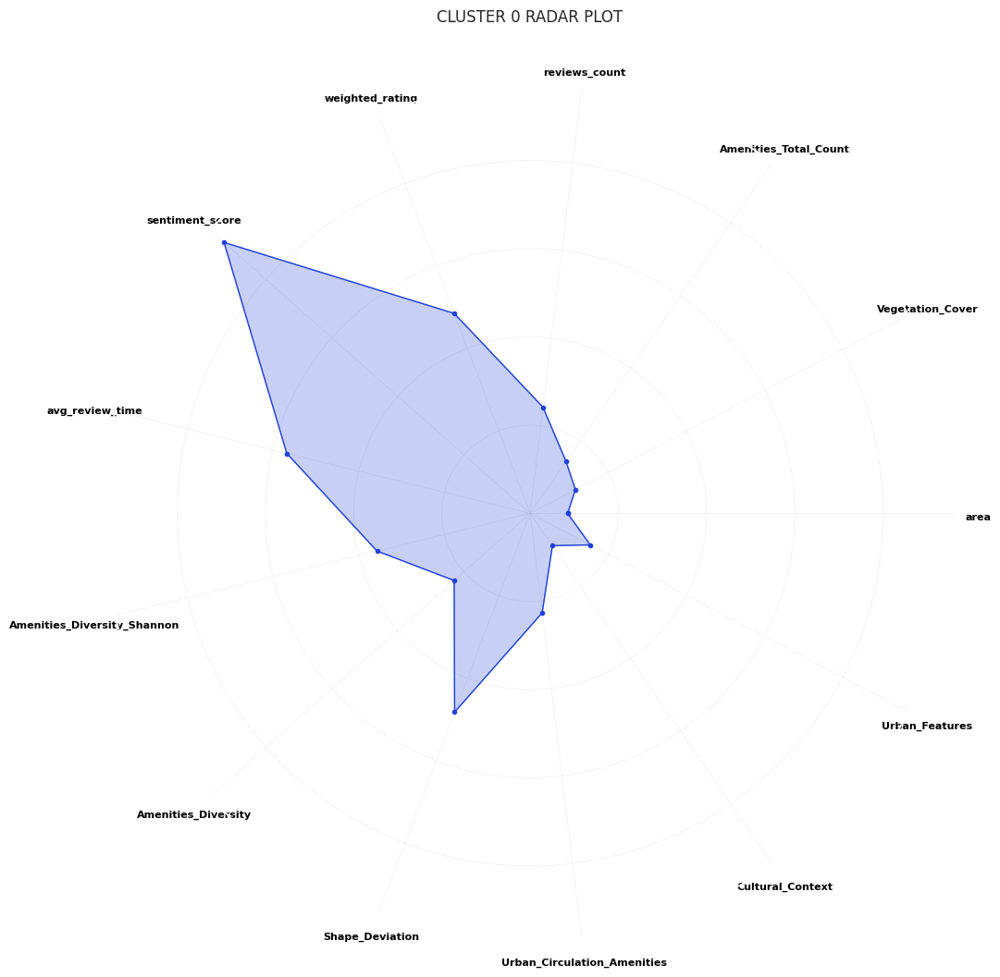

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.preprocessing import MinMaxScaler

# Your DataFrame name
df = cluster_3_data

# Drop unnecessary columns
df = df.drop(columns=['city', 'park_name', 'cluster'])

# Scale the DataFrame values between 0 to 10
scaler = MinMaxScaler(feature_range=(0, 10))
df_scaled = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)

# Compute the mean of each column
means = df_scaled.mean()

# Convert it to list for plotting
values = means.tolist()
values += values[:1]  # repeat the first value to close the circular graph

# Compute angle for each axis in the plot (divide the plot / number of variable)
angles = [n / float(len(means)) * 2 * np.pi for n in range(len(means))]
angles += angles[:1]  # repeat the first angle to close the circular graph

# Plot
fig1, ax1 = plt.subplots(figsize=(12, 12), subplot_kw=dict(polar=True))

color = np.random.rand(3,)  # Generate a random color
ax1.fill(angles, values, color=color, alpha=0.25)
ax1.plot(angles, values, color=color, linewidth=1, linestyle='solid', marker='o', markersize=3)  # added marker 'o' with size 3
ax1.set_title('Cluster 0 Radar plot'.upper(), pad=50, loc='center', fontsize=12)  # Moved title up with pad=50
ax1.set_xticks(angles[:-1])
ax1.set_xticklabels(df.columns, color='black', size=8, horizontalalignment='center', verticalalignment='top', fontweight='bold')  # Offset the labels with horizontalalignment='center'
ax1.set_yticklabels([])
ax1.grid(linestyle='dotted')
ax1.set_rlabel_position(0)

plt.show()


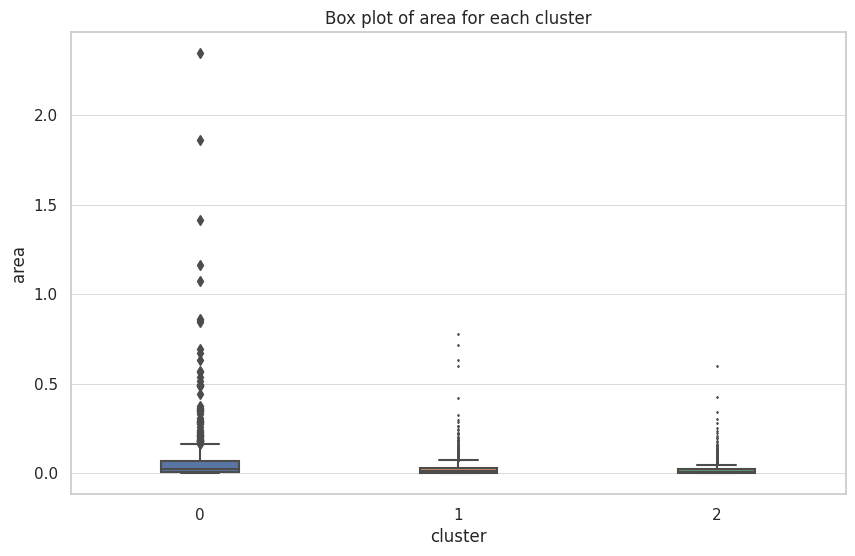

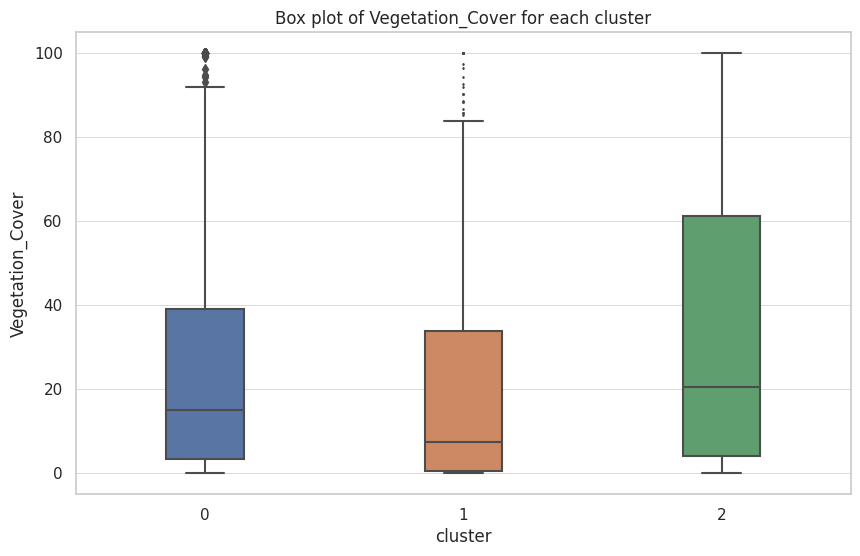

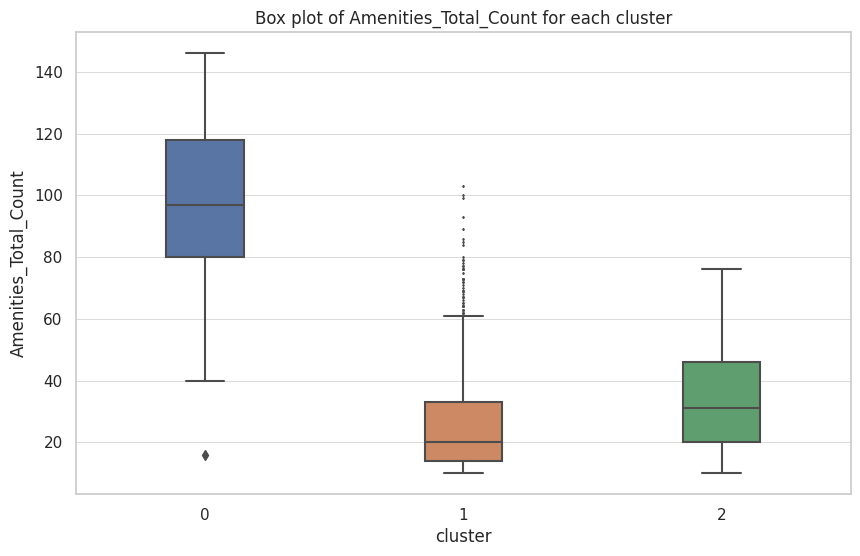

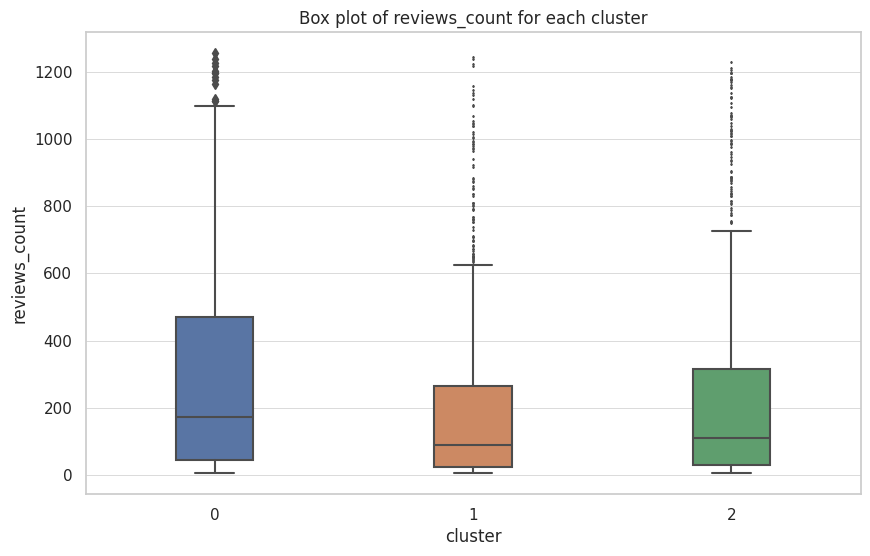

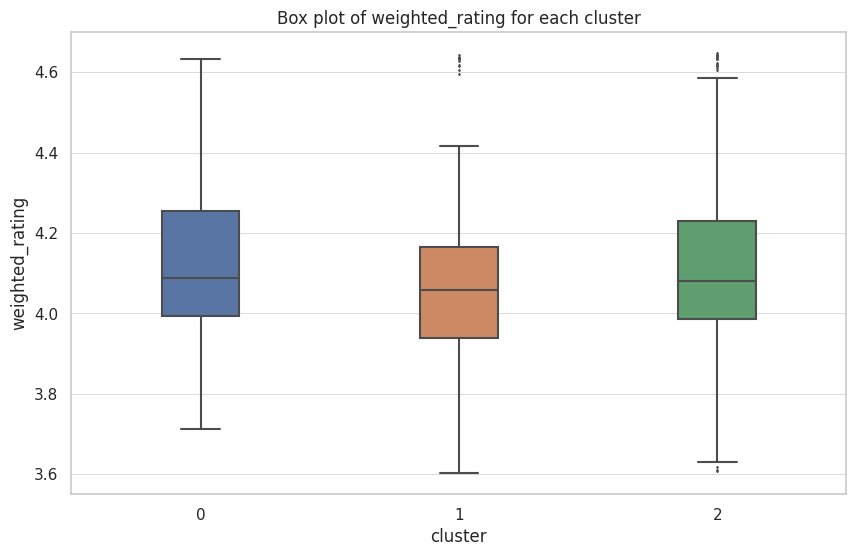

...

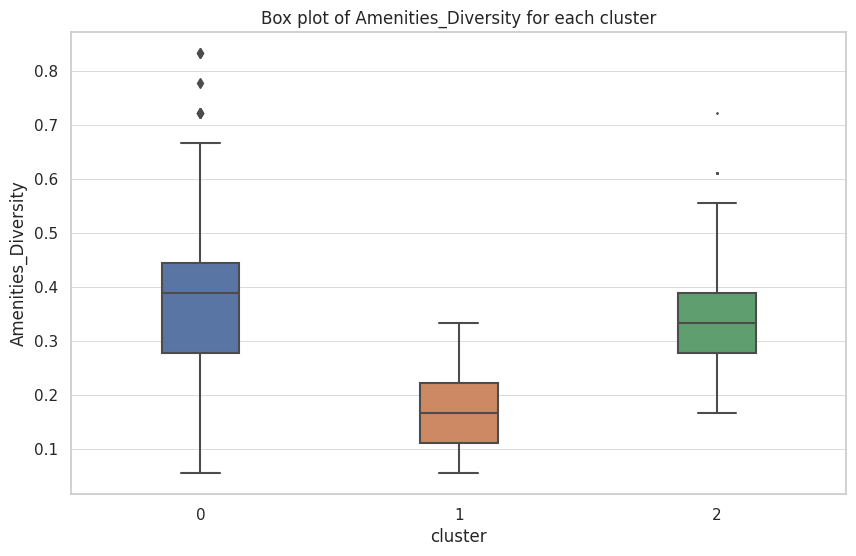

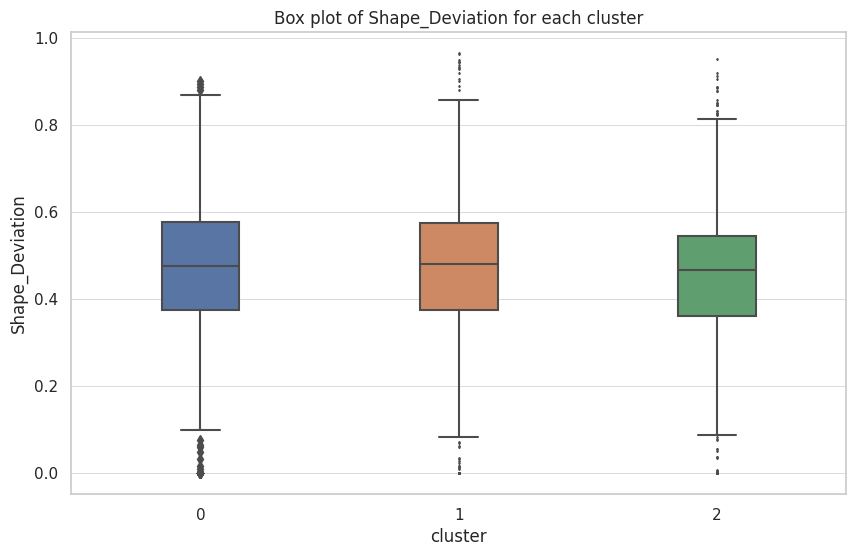

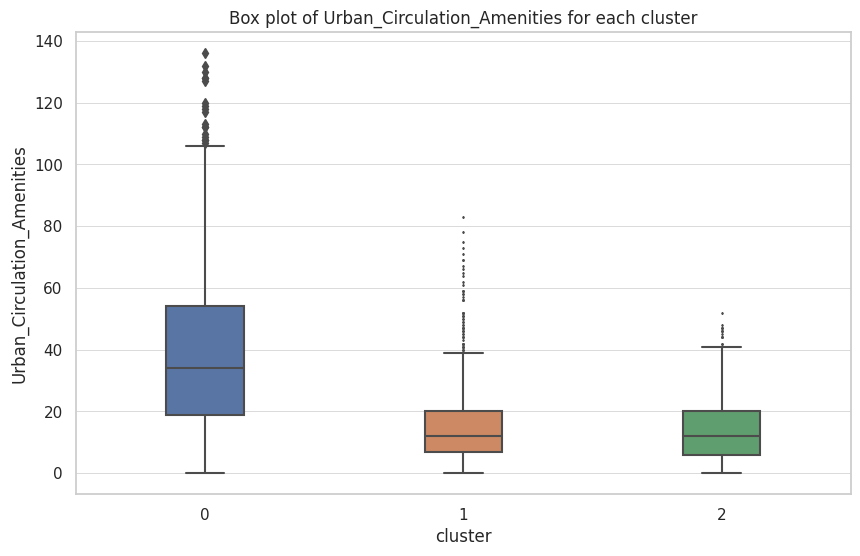

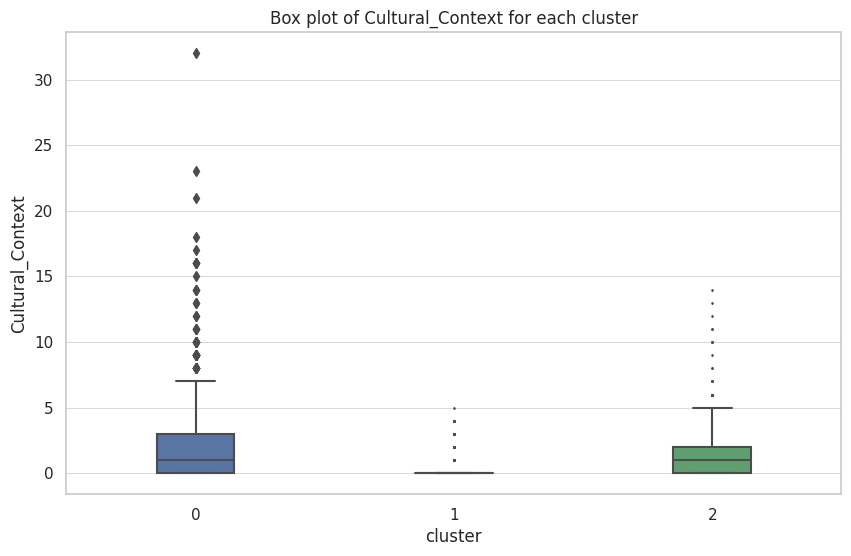

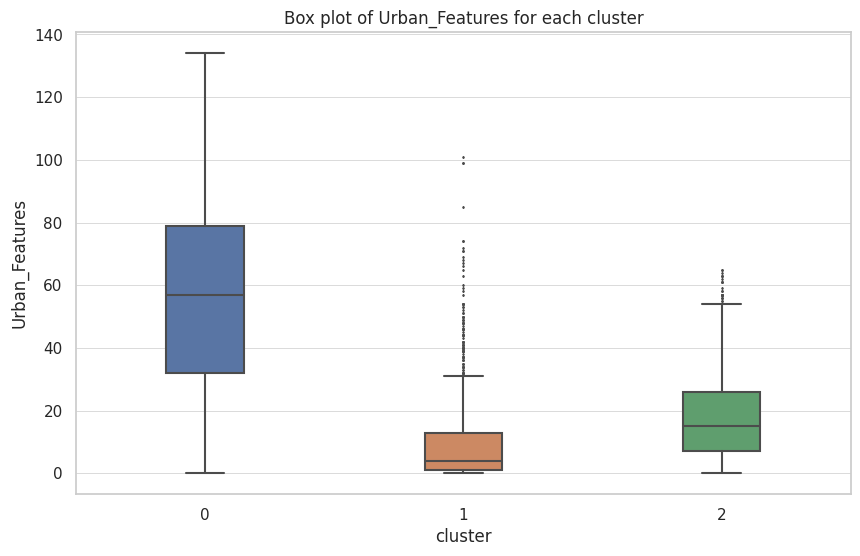

In [ ]:
import seaborn as sns

# Suppose features is a list of your feature names
features = data_num.columns

# Set the style and color palette
sns.set_style("whitegrid")
palette = sns.color_palette("deep", 3)  # We have 3 clusters

# Marker size for the outliers
fliersize = 1

for feature in features:
    fig, ax = plt.subplots(figsize=(10,6))

    # Create a boxplot for each feature, stratified by cluster
    box_plot = sns.boxplot(x='cluster', y=feature, data=data, ax=ax, palette=palette, width=0.3)

    # Get the underlying matplotlib boxplot object
    for flier in box_plot.get_lines()[len(box_plot.get_lines())//2:]:
        # Adjust the size of the flier markers (outliers)
        flier.set_markersize(fliersize)

    plt.title(f'Box plot of {feature} for each cluster')
    plt.show()


In [ ]:
kmeans = KMeans(n_clusters=3)
kmeans.fit(data_num) # Here, data_num should be the data you want to cluster
data_num['cluster'] = kmeans.labels_  # add the cluster labels to the DataFrame


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


             area  Vegetation_Cover  Amenities_Total_Count  reviews_count  \
cluster                                                                     
0       -0.005535         -0.024398               0.014436       0.042597   
1       -0.032980          0.040984              -0.096091      -0.018334   
2        0.018730         -0.000879               0.032686      -0.022294   

         weighted_rating  sentiment_score  avg_review_time  \
cluster                                                      
0               0.016942         0.019703         1.064590   
1               0.001632        -0.018673        -1.435538   
2              -0.012862        -0.005749        -0.119575   

         Amenities_Diversity_Shannon  Amenities_Diversity  Shape_Deviation  \
cluster                                                                      
0                          -0.001127             0.022602         0.008616   
1                          -0.056191            -0.111946         0.0

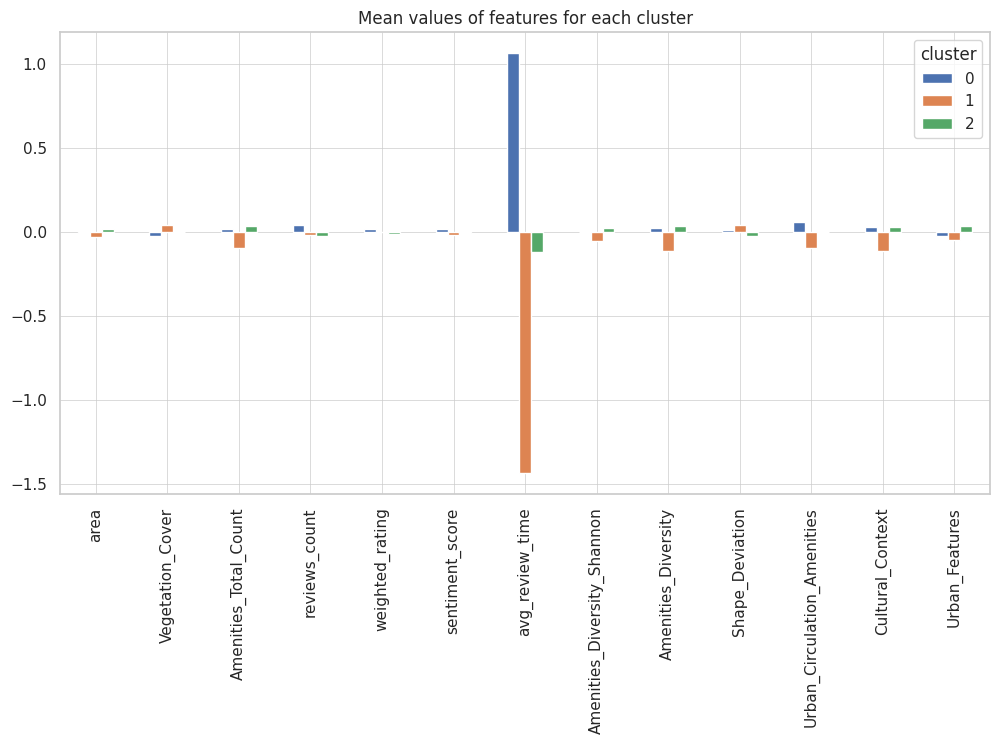

             area  Vegetation_Cover  Amenities_Total_Count  reviews_count  \
cluster                                                                     
0       -0.252082         -0.482264              -0.376809      -0.385994   
1       -0.273115         -0.441789              -0.463970      -0.452104   
2       -0.255089         -0.478744              -0.318701      -0.443170   

         weighted_rating  sentiment_score  avg_review_time  \
cluster                                                      
0               0.011545         0.328056         0.973130   
1              -0.086178         0.325591        -1.258604   
2              -0.113697         0.314135        -0.109931   

         Amenities_Diversity_Shannon  Amenities_Diversity  Shape_Deviation  \
cluster                                                                      
0                           0.026781             0.054299         0.053242   
1                          -0.018520            -0.373615         0.1

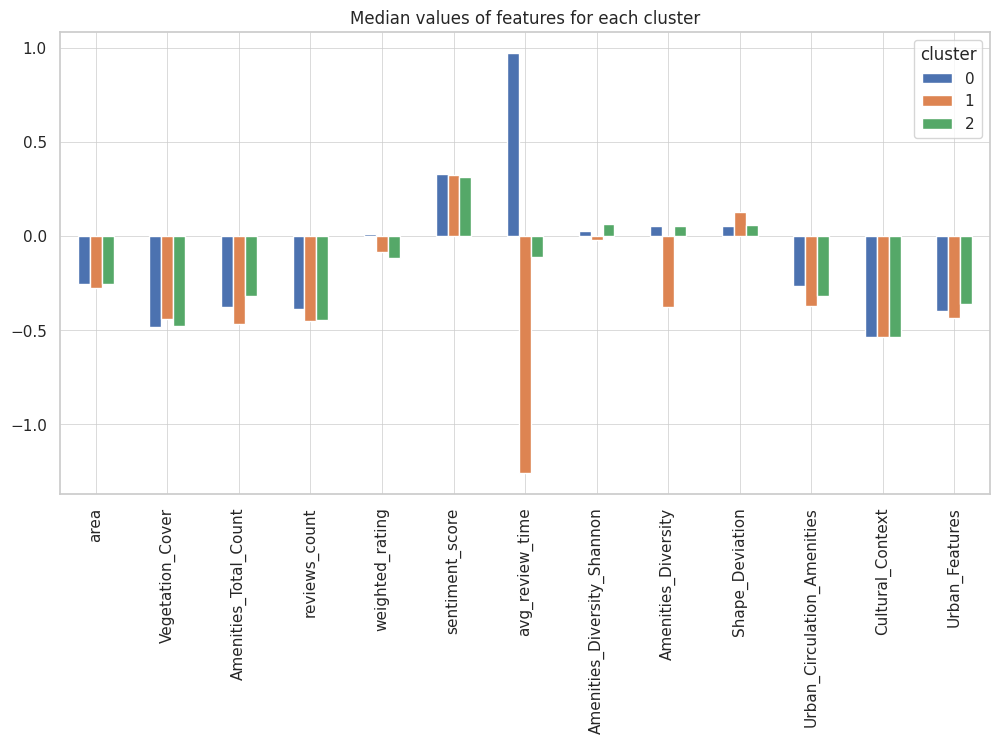

       area  Vegetation_Cover  Amenities_Total_Count  reviews_count  \
0  0.040353       1018.610125            1609.586544   67943.835585   
1  0.040088       1096.066607            1478.932401   63301.666509   
2  0.040588       1045.015427            1631.674936   63087.921936   

   weighted_rating  sentiment_score  avg_review_time  \
0         4.766073         1.168165     6.160708e+08   
1         4.765612         1.163638     3.634062e+08   
2         4.765184         1.165201     4.964107e+08   

   Amenities_Diversity_Shannon  Amenities_Diversity  Shape_Deviation  \
0                     1.324723             0.306249         0.546906   
1                     1.313165             0.303990         0.548083   
2                     1.330173             0.306454         0.545813   

   Urban_Circulation_Amenities  Cultural_Context  Urban_Features  
0                   425.035601          3.903977      645.212430  
1                   369.402094          3.227793      629.612667  


In [ ]:
from sklearn.preprocessing import StandardScaler

# Standardize the features
scaler = StandardScaler()
data_num_std = pd.DataFrame(scaler.fit_transform(data_num.drop(columns=['cluster'])), columns=data_num.columns[:-1])
data_num_std['cluster'] = data_num['cluster']  # add back the cluster labels

# Group by the cluster label and take the mean for each group (i.e., each cluster)
cluster_means = data_num_std.groupby('cluster').mean()

# Print and plot the means across clusters
print(cluster_means)
cluster_means.T.plot(kind='bar', figsize=(12,6))
plt.title('Mean values of features for each cluster')
plt.show()

# Do the same for medians
cluster_medians = data_num_std.groupby('cluster').median()
print(cluster_medians)
cluster_medians.T.plot(kind='bar', figsize=(12,6))
plt.title('Median values of features for each cluster')
plt.show()

# Get the centroids in the original feature space
centroids = scaler.inverse_transform(kmeans.cluster_centers_)
centroids_df = pd.DataFrame(centroids, columns=data_num.columns[:-1])
print(centroids_df)


<ipython-input-13-79fa49a8c06c>:10: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  cluster_summary = data.groupby('cluster').mean()


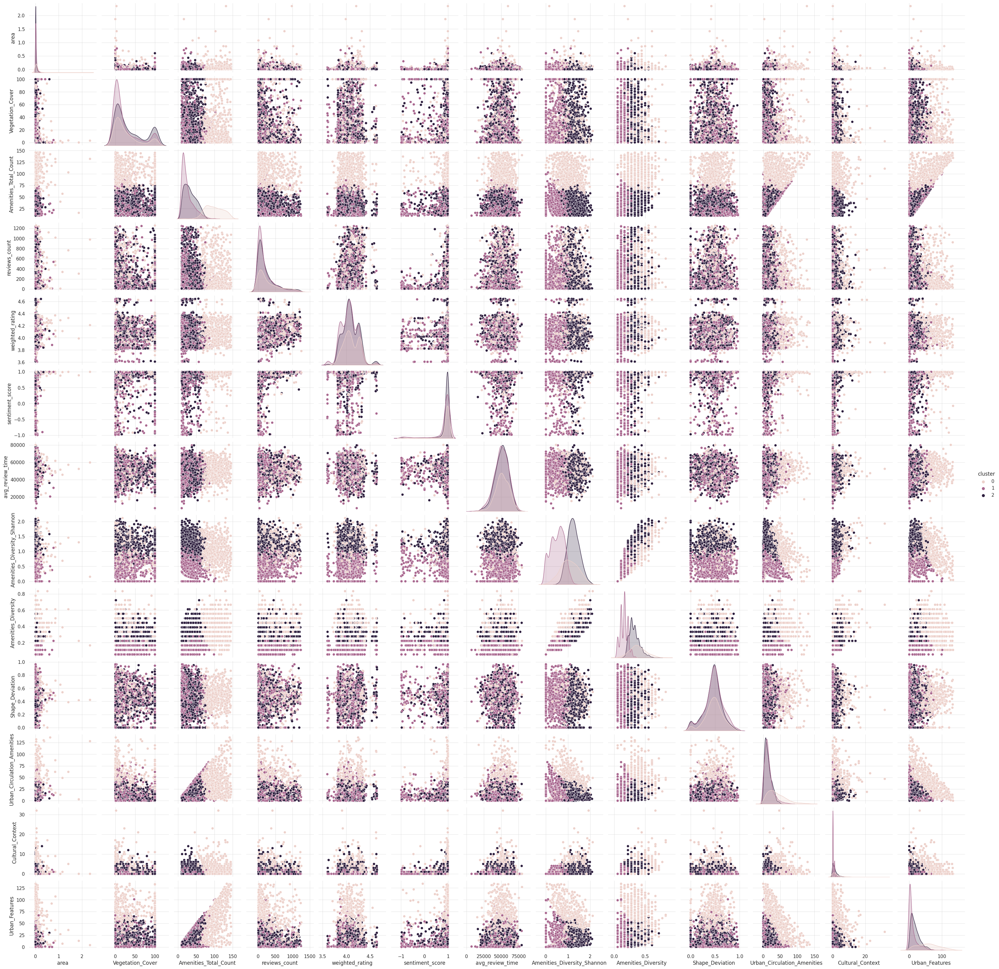

In [ ]:
import seaborn as sns

# Assume data is your original dataframe and labels are the clusters obtained from K-means
data['cluster'] = kmeans.labels_

# Pairplot
sns.pairplot(data, hue='cluster')

# Mean/Median of features across clusters
cluster_summary = data.groupby('cluster').mean()


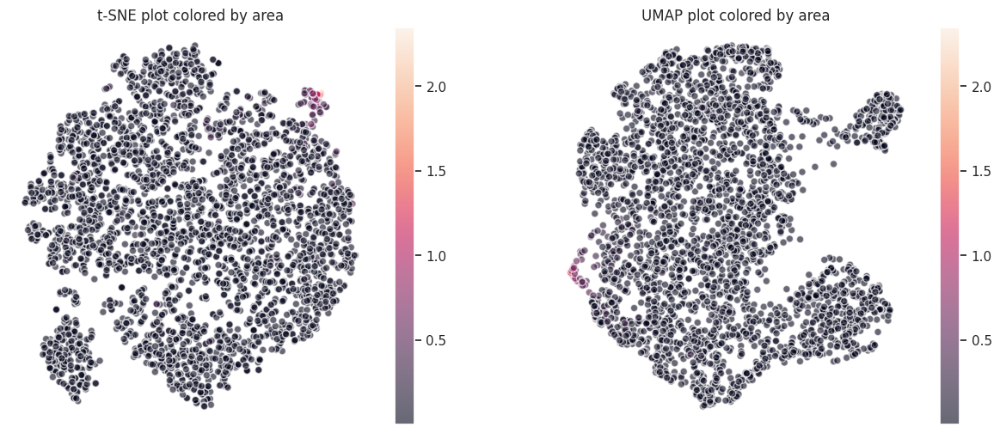

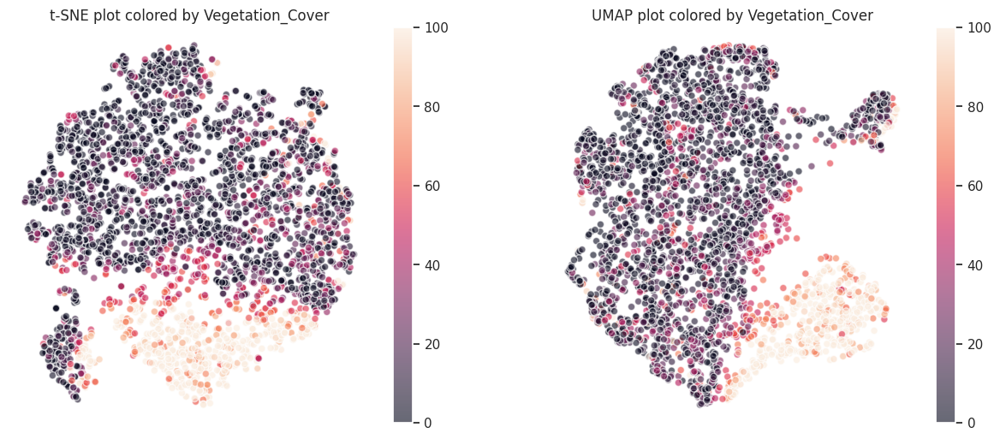

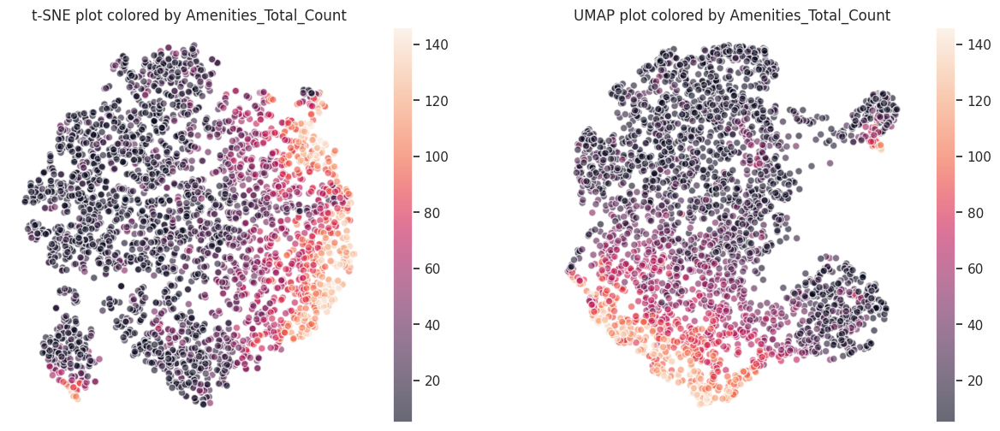

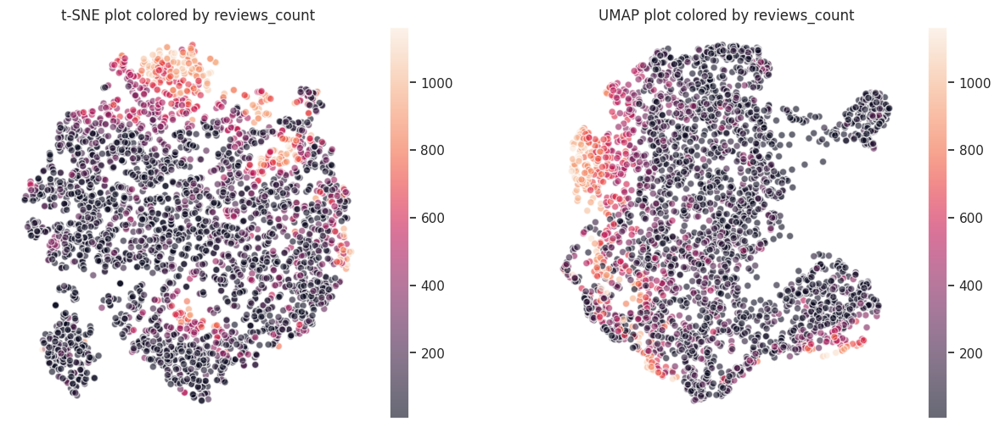

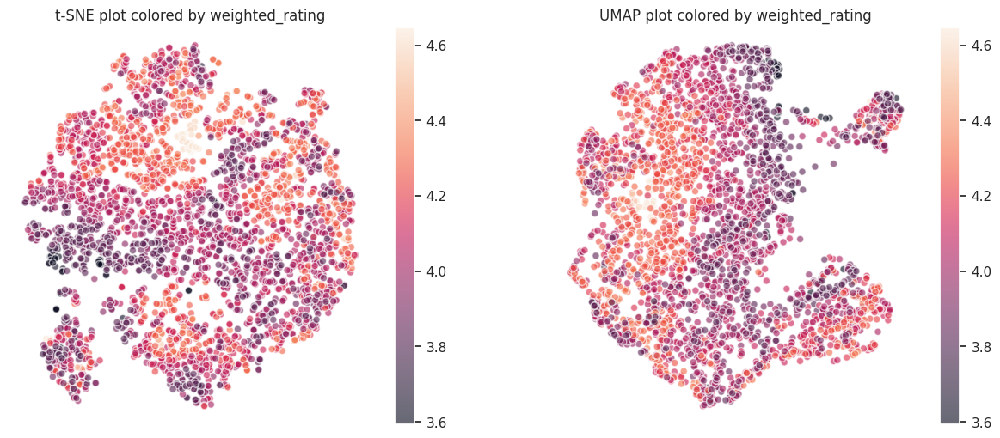

...

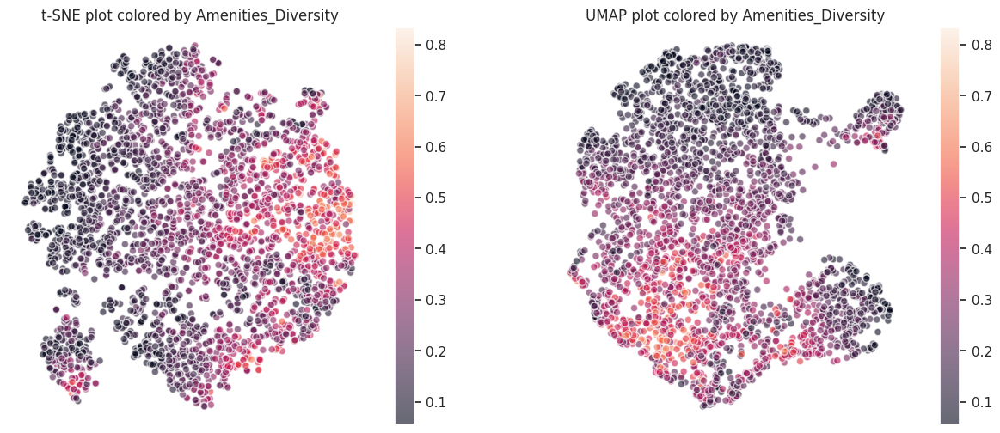

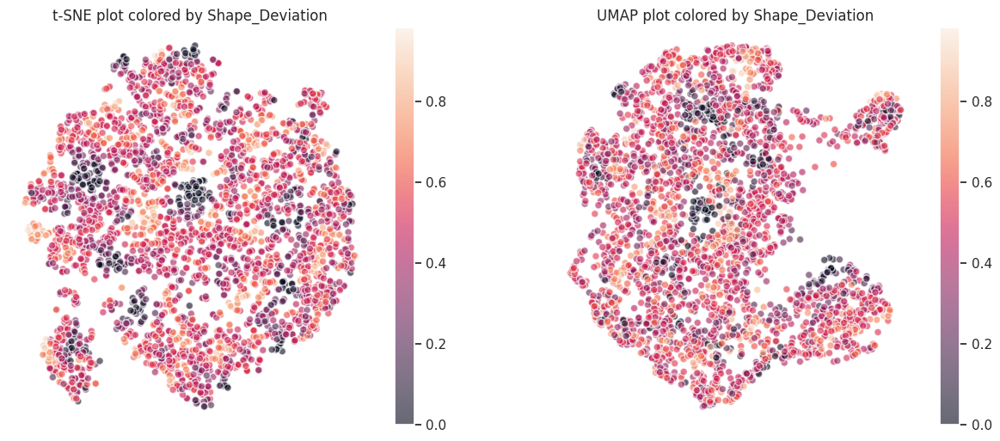

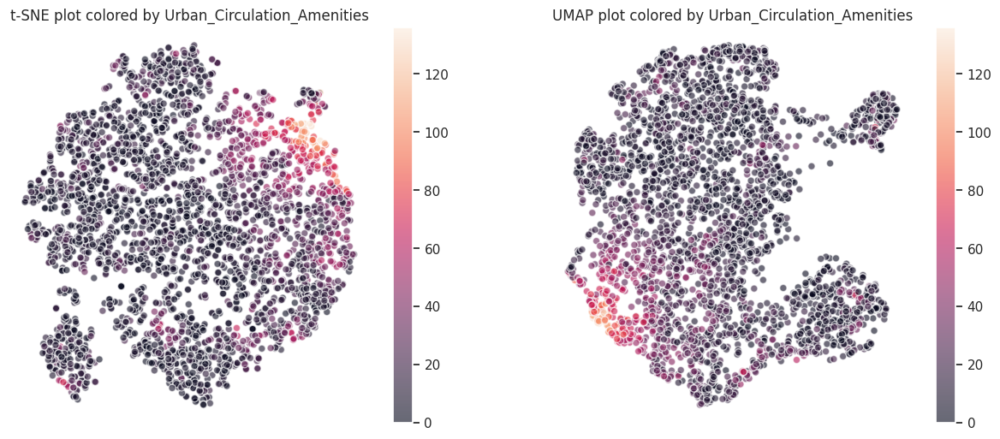

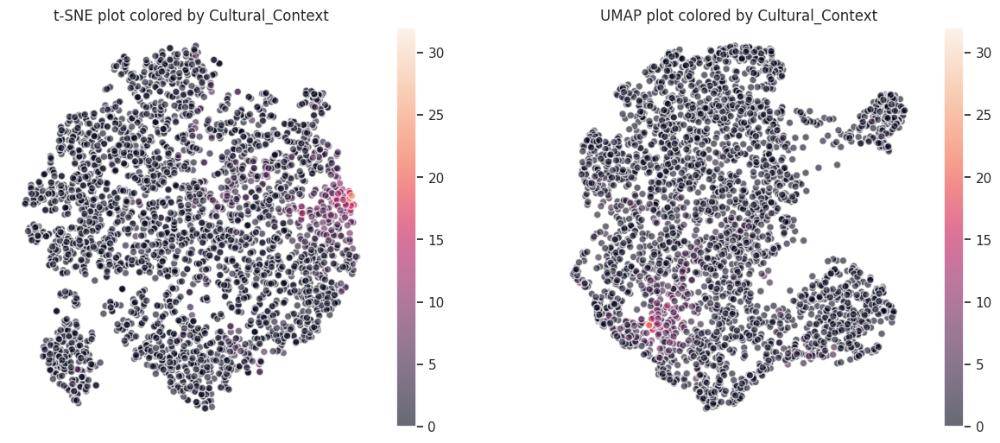

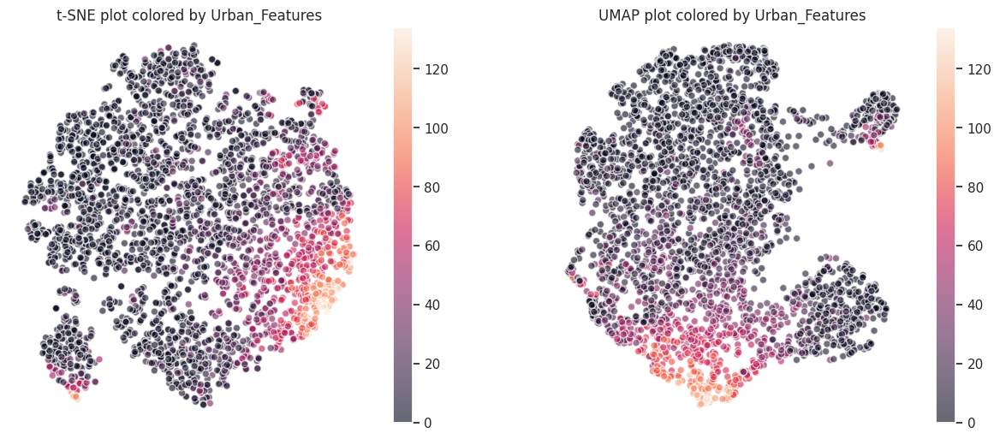

In [ ]:
import matplotlib.pyplot as plt

# Adjust plot style
plt.rcParams['axes.facecolor'] = 'white' # makes the background white
plt.rcParams['grid.color'] = 'lightgrey' # makes gridlines light grey
plt.rcParams['grid.linestyle'] = '-' # defines the style of the gridlines
plt.rcParams['grid.linewidth'] = 0.5 # defines the width of the gridlines

# We'll use all numerical columns.
features_to_plot = data_num.columns.tolist()

for feature in features_to_plot:
    fig, axs = plt.subplots(1, 2, figsize=(15, 6))

    # t-SNE plot
    scatter = axs[0].scatter(tsne_df['TSNE1'], tsne_df['TSNE2'], c=data_num[feature], alpha=0.6, edgecolors='w')
    axs[0].set_title(f't-SNE plot colored by {feature}', fontsize=12)
    fig.colorbar(scatter, ax=axs[0])
    axs[0].grid(True)  # Add gridlines
    axs[0].set_xticks([])  # Remove x-axis values
    axs[0].set_yticks([])  # Remove y-axis values

    # UMAP plot
    scatter = axs[1].scatter(umap_df['UMAP1'], umap_df['UMAP2'], c=data_num[feature], alpha=0.6, edgecolors='w')
    axs[1].set_title(f'UMAP plot colored by {feature}', fontsize=12)
    fig.colorbar(scatter, ax=axs[1])
    axs[1].grid(True)  # Add gridlines
    axs[1].set_xticks([])  # Remove x-axis values
    axs[1].set_yticks([])  # Remove y-axis values

    plt.show()


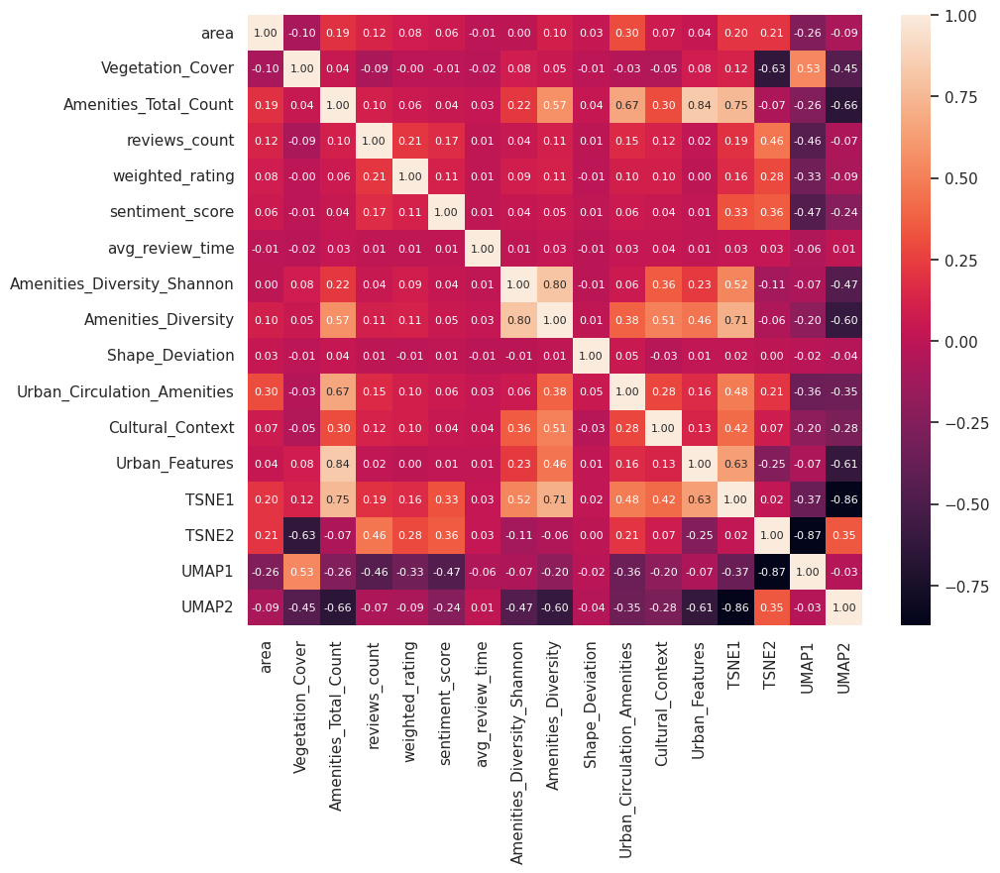

In [ ]:
# Import necessary library
import seaborn as sns

# Convert tsne and umap results into DataFrame
tsne_df = pd.DataFrame(tsne_results, columns=["TSNE1", "TSNE2"])
umap_df = pd.DataFrame(umap_results, columns=["UMAP1", "UMAP2"])

# Concatenate the original and transformed features
combined_data = pd.concat([data_num, tsne_df, umap_df], axis=1)

# Compute the correlation matrix
corr_matrix = combined_data.corr()

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", annot_kws={"size": 8})  # Set annotation font size to 8
plt.show()


In [ ]:
from sklearn.metrics import silhouette_score

# Assume that 'kmeans' is your fitted KMeans model and 'data_scaled' is your scaled data
labels = kmeans.labels_
silhouette_avg = silhouette_score(data_scaled, labels)

print("The average silhouette_score is :", silhouette_avg)


The average silhouette_score is : 0.0307555750263231


In [ ]:
# Assume that 'data' is your original DataFrame and 'labels' are the cluster labels
data['cluster'] = labels

# Compute descriptive statistics for each cluster
cluster_descriptive_stats = data.groupby('cluster').describe()

print(cluster_descriptive_stats)


           area                                                              \
          count      mean       std       min       25%       50%       75%   
cluster                                                                       
0         918.0  0.036243  0.110149  0.000310  0.004349  0.011984  0.031943   
1         574.0  0.033542  0.070532  0.000213  0.004351  0.009914  0.033140   
2        1282.0  0.038630  0.100231  0.000240  0.004015  0.011688  0.035628   

                  Vegetation_Cover                                       \
              max            count       mean        std  min       25%   
cluster                                                                   
0        2.347218            918.0  28.516209  33.915417  0.0  2.400398   
1        0.776843            574.0  30.781922  35.809738  0.0  2.489337   
2        1.863992           1282.0  29.331208  34.670787  0.0  2.036921   

                                     Amenities_Total_Count             \
 

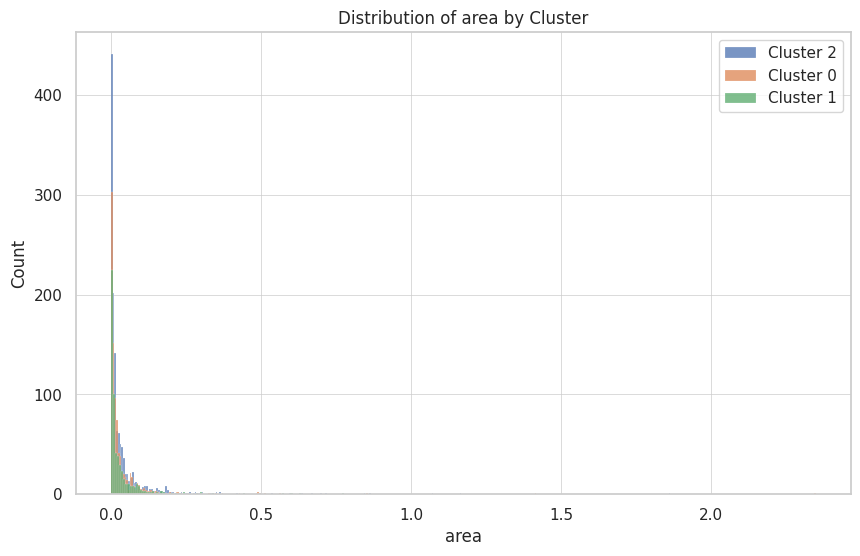

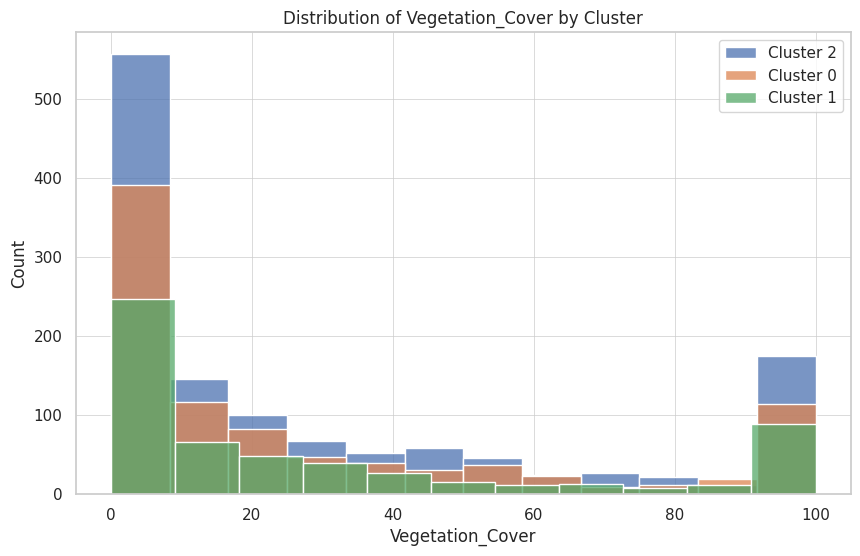

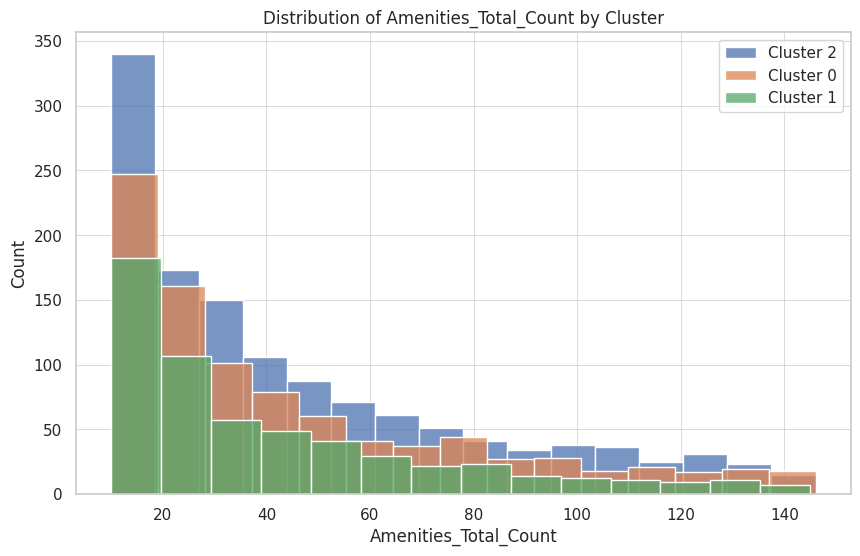

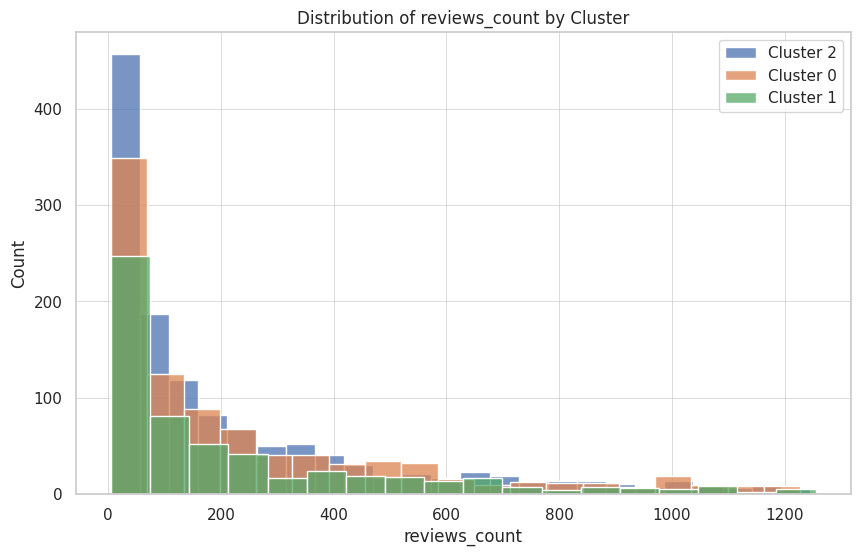

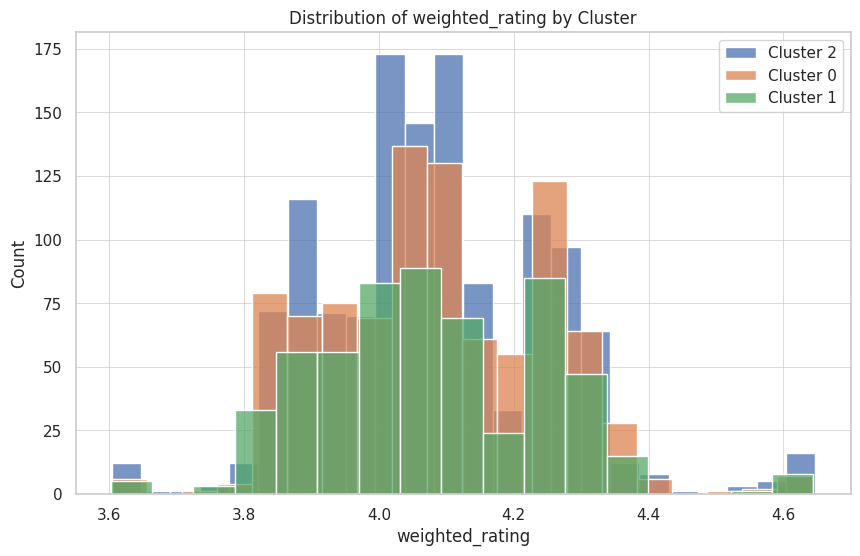

...

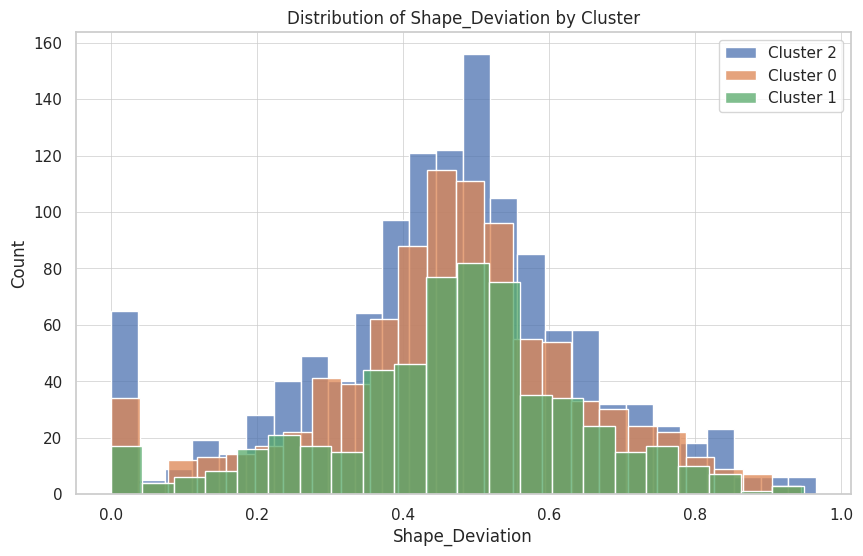

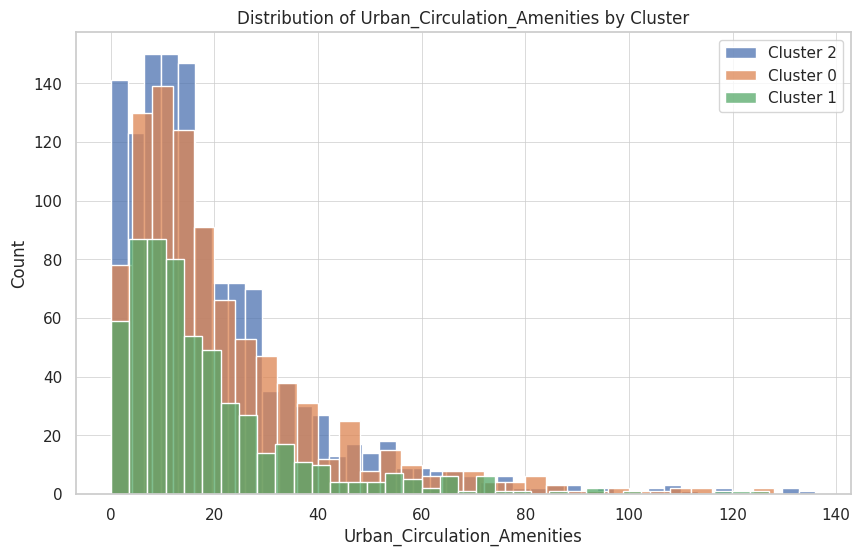

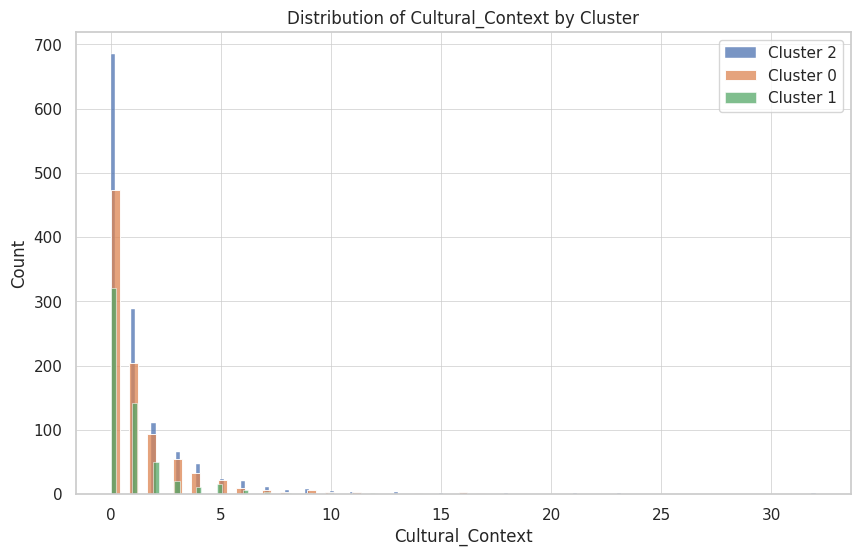

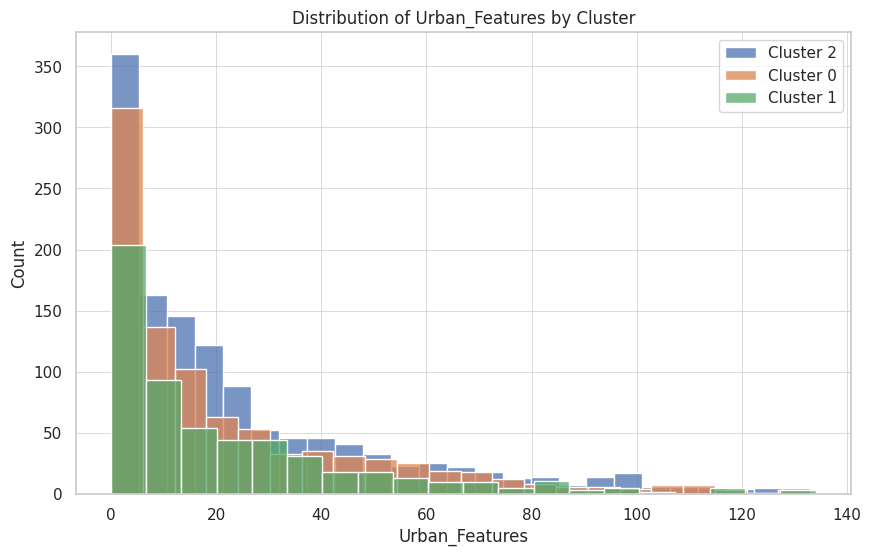

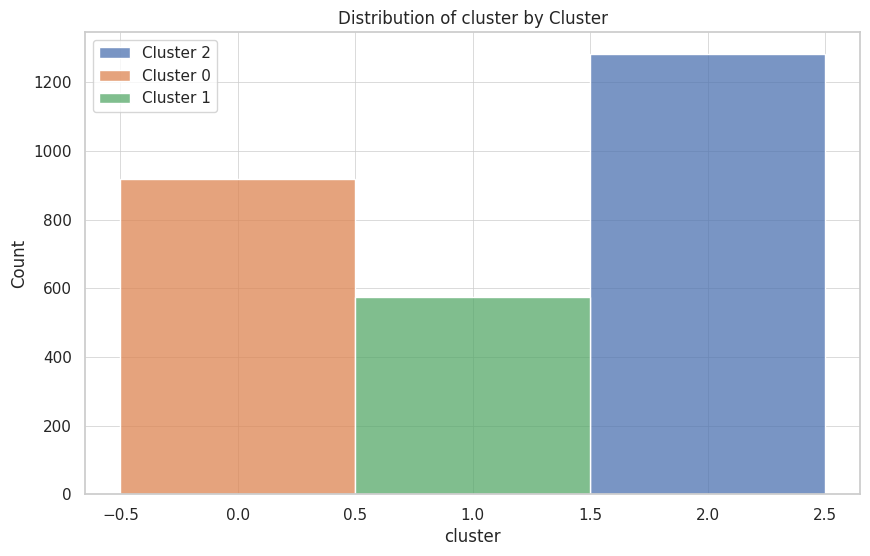

In [ ]:
# Assume that 'data_num' is your DataFrame containing only numeric columns
for column in data_num.columns:
    plt.figure(figsize=(10, 6))
    for cluster in data['cluster'].unique():
        sns.histplot(data_num.loc[data['cluster'] == cluster, column], kde=False, label=f'Cluster {cluster}')
    plt.title(f'Distribution of {column} by Cluster')
    plt.legend()
    plt.show()


In [ ]:
centroids_df

,area,Vegetation_Cover,Amenities_Total_Count,reviews_count,weighted_rating,sentiment_score,avg_review_time,Amenities_Diversity,Shape_Deviation,Urban_Circulation_Amenities,Cultural_Context,Urban_Features
0,0.040353,1018.610125,1609.586544,67943.835585,4.766073,1.168165,6.160708e+08,0.306249,0.546906,425.035601,3.903977,645.212430
1,0.040088,1096.066607,1478.932401,63301.666509,4.765612,1.163638,3.634062e+08,0.303990,0.548083,369.402094,3.227793,629.612667
2,0.040588,1045.015427,1631.674936,63087.921936,4.765184,1.165201,4.964107e+08,0.306454,0.545813,405.397489,3.924848,689.980347


In [ ]:
# Normalize per row
for i, row in centroids_df.iterrows():
    row_to_normalize = row.drop(['avg_review_time', 'reviews_count'])
    normalized_row = ((row_to_normalize - row_to_normalize.min()) /
                      (row_to_normalize.max() - row_to_normalize.min())) * 10
    centroids_df_adjusted.loc[i, normalized_row.index] = normalized_row

# Set 'avg_review_time' and 'reviews_count' manually
centroids_df_adjusted['avg_review_time'] = [6, 3, 5]
centroids_df_adjusted['reviews_count'] = [6.3, 6.3, 6.3]

# Generate the radar plots
for i, row in centroids_df_adjusted.iterrows():
    plot_spider(row, f'Cluster {i}')
